# Temperature Forecast Project

In [60]:
# ----------------------------------------Importing libraries--------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

## Data Description 

### Temperature Forecast Project using ML
#### Problem Statement:
###### Data Set Information:

This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.


###### Attribute Information:

For more information, read [Cho et al, 2020].
1. station - used weather station number: 1 to 25
2. Date - Present day: yyyy-mm-dd ('2013-06-30' to '2017-08-30')
3. Present_Tmax - Maximum air temperature between 0 and 21 h on the present day (Â°C): 20 to 37.6
4. Present_Tmin - Minimum air temperature between 0 and 21 h on the present day (Â°C): 11.3 to 29.9
5. LDAPS_RHmin - LDAPS model forecast of next-day minimum relative humidity (%): 19.8 to 98.5
6. LDAPS_RHmax - LDAPS model forecast of next-day maximum relative humidity (%): 58.9 to 100
7. LDAPS_Tmax_lapse - LDAPS model forecast of next-day maximum air temperature applied lapse rate (Â°C): 17.6 to 38.5
8. LDAPS_Tmin_lapse - LDAPS model forecast of next-day minimum air temperature applied lapse rate (Â°C): 14.3 to 29.6
9. LDAPS_WS - LDAPS model forecast of next-day average wind speed (m/s): 2.9 to 21.9
10. LDAPS_LH - LDAPS model forecast of next-day average latent heat flux (W/m2): -13.6 to 213.4
11. LDAPS_CC1 - LDAPS model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%): 0 to 0.97
12. LDAPS_CC2 - LDAPS model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%): 0 to 0.97
13. LDAPS_CC3 - LDAPS model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%): 0 to 0.98
14. LDAPS_CC4 - LDAPS model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%): 0 to 0.97
15. LDAPS_PPT1 - LDAPS model forecast of next-day 1st 6-hour split average precipitation (0-5 h) (%): 0 to 23.7
16. LDAPS_PPT2 - LDAPS model forecast of next-day 2nd 6-hour split average precipitation (6-11 h) (%): 0 to 21.6
17. LDAPS_PPT3 - LDAPS model forecast of next-day 3rd 6-hour split average precipitation (12-17 h) (%): 0 to 15.8
18. LDAPS_PPT4 - LDAPS model forecast of next-day 4th 6-hour split average precipitation (18-23 h) (%): 0 to 16.7
19. lat - Latitude (Â°): 37.456 to 37.645
20. lon - Longitude (Â°): 126.826 to 127.135
21. DEM - Elevation (m): 12.4 to 212.3
22. Slope - Slope (Â°): 0.1 to 5.2
23. Solar radiation - Daily incoming solar radiation (wh/m2): 4329.5 to 5992.9
24. Next_Tmax - The next-day maximum air temperature (Â°C): 17.4 to 38.9
25. Next_Tmin - The next-day minimum air temperature (Â°C): 11.3 to 29.8T

Please note that there are two target variables here: 

1) Next_Tmax: Next day maximum temperature

2) Next_Tmin: Next day  minimum temperature

## Import Data

In [61]:
link = 'https://raw.githubusercontent.com/Bhushan0130/Datasets/main/temperature.csv'
df = pd.read_csv(link, parse_dates = ['Date'])
df.shape   #(7752, 25)

(7752, 25)

In [62]:
df.head() # Top 5 rows

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [65]:
# to maximize row and columns
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

## Checking dtypes of the columns 

In [66]:
df.dtypes 
# All columns are of float type except Date column
# Date column is in datatime format

# station                    float64
# Date                datetime64[ns]
# Present_Tmax               float64
# Present_Tmin               float64
# LDAPS_RHmin                float64
# LDAPS_RHmax                float64
# LDAPS_Tmax_lapse           float64
# LDAPS_Tmin_lapse           float64
# LDAPS_WS                   float64
# LDAPS_LH                   float64
# LDAPS_CC1                  float64
# LDAPS_CC2                  float64
# LDAPS_CC3                  float64
# LDAPS_CC4                  float64
# LDAPS_PPT1                 float64
# LDAPS_PPT2                 float64
# LDAPS_PPT3                 float64
# LDAPS_PPT4                 float64
# lat                        float64
# lon                        float64
# DEM                        float64
# Slope                      float64
# Solar radiation            float64
# Next_Tmax                  float64
# Next_Tmin                  float64

station                    float64
Date                datetime64[ns]
Present_Tmax               float64
Present_Tmin               float64
LDAPS_RHmin                float64
LDAPS_RHmax                float64
LDAPS_Tmax_lapse           float64
LDAPS_Tmin_lapse           float64
LDAPS_WS                   float64
LDAPS_LH                   float64
LDAPS_CC1                  float64
LDAPS_CC2                  float64
LDAPS_CC3                  float64
LDAPS_CC4                  float64
LDAPS_PPT1                 float64
LDAPS_PPT2                 float64
LDAPS_PPT3                 float64
LDAPS_PPT4                 float64
lat                        float64
lon                        float64
DEM                        float64
Slope                      float64
Solar radiation            float64
Next_Tmax                  float64
Next_Tmin                  float64
dtype: object

In [67]:
df.info()  
# dateset having 7752 rows and 25 columns
# All column are not containing same count of non-null values, means null values are present in the datast

#   Column            Non-Null Count  Dtype         
# ---  ------            --------------  -----         
#  0   station           7750 non-null   float64       
#  1   Date              7750 non-null   datetime64[ns]
#  2   Present_Tmax      7682 non-null   float64       
#  3   Present_Tmin      7682 non-null   float64       
#  4   LDAPS_RHmin       7677 non-null   float64       
#  5   LDAPS_RHmax       7677 non-null   float64       
#  6   LDAPS_Tmax_lapse  7677 non-null   float64       
#  7   LDAPS_Tmin_lapse  7677 non-null   float64       
#  8   LDAPS_WS          7677 non-null   float64       
#  9   LDAPS_LH          7677 non-null   float64       
#  10  LDAPS_CC1         7677 non-null   float64       
#  11  LDAPS_CC2         7677 non-null   float64       
#  12  LDAPS_CC3         7677 non-null   float64       
#  13  LDAPS_CC4         7677 non-null   float64       
#  14  LDAPS_PPT1        7677 non-null   float64       
#  15  LDAPS_PPT2        7677 non-null   float64       
#  16  LDAPS_PPT3        7677 non-null   float64       
#  17  LDAPS_PPT4        7677 non-null   float64       
#  18  lat               7752 non-null   float64       
#  19  lon               7752 non-null   float64       
#  20  DEM               7752 non-null   float64       
#  21  Slope             7752 non-null   float64       
#  22  Solar radiation   7752 non-null   float64       
#  23  Next_Tmax         7725 non-null   float64       
#  24  Next_Tmin         7725 non-null   float64 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   station           7750 non-null   float64       
 1   Date              7750 non-null   datetime64[ns]
 2   Present_Tmax      7682 non-null   float64       
 3   Present_Tmin      7682 non-null   float64       
 4   LDAPS_RHmin       7677 non-null   float64       
 5   LDAPS_RHmax       7677 non-null   float64       
 6   LDAPS_Tmax_lapse  7677 non-null   float64       
 7   LDAPS_Tmin_lapse  7677 non-null   float64       
 8   LDAPS_WS          7677 non-null   float64       
 9   LDAPS_LH          7677 non-null   float64       
 10  LDAPS_CC1         7677 non-null   float64       
 11  LDAPS_CC2         7677 non-null   float64       
 12  LDAPS_CC3         7677 non-null   float64       
 13  LDAPS_CC4         7677 non-null   float64       
 14  LDAPS_PPT1        7677 n

#### As columns target variable is of float type, so this is an regression 


## Null value analysis

In [68]:
df.isnull().sum().sum()  
# 1248 null values are present in the dataset

1248

<AxesSubplot:>

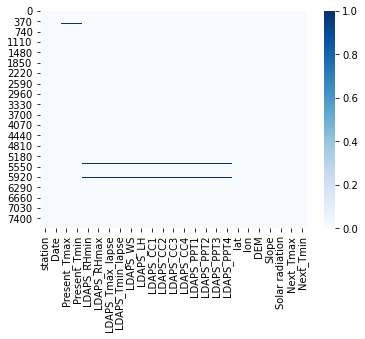

In [69]:
sns.heatmap(df.isnull() , cmap = 'Blues')    # Heatmap for null value

In [70]:
# As observed from the heat map, maximum not null values are present in the same row, therfore it is better to delete null value
# rows to build a good model

In [71]:
df.shape
# (7752, 25)

(7752, 25)

##### Drop NaN 

In [72]:
new_df = df.dropna()
new_df.shape  
# (7588, 25)

(7588, 25)

In [73]:
(df.shape[0] - new_df.shape[0]) / df.shape[0] * 100

# 2.1155830753353975 % Data loss we are getting by droping na value rows 

2.1155830753353975

In [74]:
df.dropna(inplace = True)  # Applying to original dataset

In [75]:
df.shape

# (7588, 25)

(7588, 25)

<AxesSubplot:>

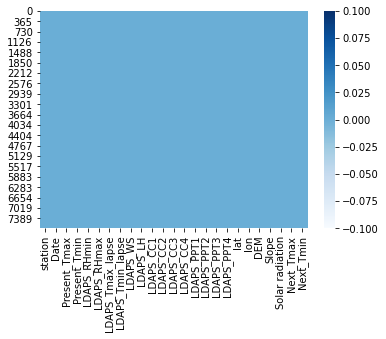

In [76]:
sns.heatmap(df.isnull() , cmap = 'Blues')    # Heatmap for null value
# As we can see heatmap is clear, no null values are present in the dataset

### Data Preprocessing

In [77]:
df.dtypes

# station                    float64
# Date                datetime64[ns]
# Present_Tmax               float64
# Present_Tmin               float64
# LDAPS_RHmin                float64
# LDAPS_RHmax                float64
# LDAPS_Tmax_lapse           float64
# LDAPS_Tmin_lapse           float64
# LDAPS_WS                   float64
# LDAPS_LH                   float64
# LDAPS_CC1                  float64
# LDAPS_CC2                  float64
# LDAPS_CC3                  float64
# LDAPS_CC4                  float64
# LDAPS_PPT1                 float64
# LDAPS_PPT2                 float64
# LDAPS_PPT3                 float64
# LDAPS_PPT4                 float64
# lat                        float64
# lon                        float64
# DEM                        float64
# Slope                      float64
# Solar radiation            float64
# Next_Tmax                  float64
# Next_Tmin                  float64

station                    float64
Date                datetime64[ns]
Present_Tmax               float64
Present_Tmin               float64
LDAPS_RHmin                float64
LDAPS_RHmax                float64
LDAPS_Tmax_lapse           float64
LDAPS_Tmin_lapse           float64
LDAPS_WS                   float64
LDAPS_LH                   float64
LDAPS_CC1                  float64
LDAPS_CC2                  float64
LDAPS_CC3                  float64
LDAPS_CC4                  float64
LDAPS_PPT1                 float64
LDAPS_PPT2                 float64
LDAPS_PPT3                 float64
LDAPS_PPT4                 float64
lat                        float64
lon                        float64
DEM                        float64
Slope                      float64
Solar radiation            float64
Next_Tmax                  float64
Next_Tmin                  float64
dtype: object

In [78]:
# Creation of New columns from Date column

In [79]:
df['Day'] = df['Date'].dt.day  # Creating Day Column from Date column
df['Month'] = df['Date'].dt.month    # Creating Day Column from Date column
df['Year'] = df['Date'].dt.year # Creating yeaer Column from Date column

In [80]:
df.shape

# (7588, 28)

(7588, 28)

In [81]:
# As all info from date column has been taken out, now we can delete the Data column

In [82]:
df.drop(columns = ['Date'], inplace = True)
df.shape

# (7588, 27)

(7588, 27)

In [83]:
df.dtypes

# station             float64
# Present_Tmax        float64
# Present_Tmin        float64
# LDAPS_RHmin         float64
# LDAPS_RHmax         float64
# LDAPS_Tmax_lapse    float64
# LDAPS_Tmin_lapse    float64
# LDAPS_WS            float64
# LDAPS_LH            float64
# LDAPS_CC1           float64
# LDAPS_CC2           float64
# LDAPS_CC3           float64
# LDAPS_CC4           float64
# LDAPS_PPT1          float64
# LDAPS_PPT2          float64
# LDAPS_PPT3          float64
# LDAPS_PPT4          float64
# lat                 float64
# lon                 float64
# DEM                 float64
# Slope               float64
# Solar radiation     float64
# Next_Tmax           float64
# Next_Tmin           float64
# Day                   int64
# Month                 int64
# Year                  int64

station             float64
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
Day                   int64
Month                 int64
Year                  int64
dtype: object

In [84]:
# all columns are of int or float

In [85]:
df.columns  # All columns of dataset

Index(['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin', 'Day', 'Month', 'Year'],
      dtype='object')

In [86]:
numeric_col = ['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin', 'Day', 'Month', 'Year']

### Visualisatiion

#### Outliers Analysis

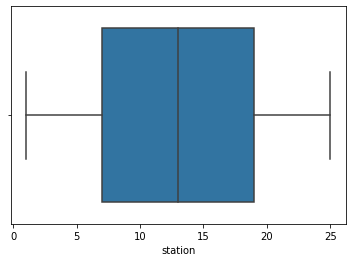

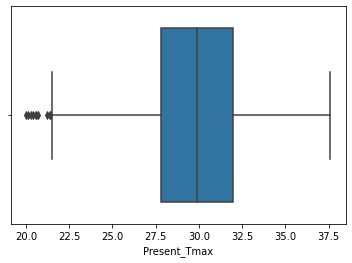

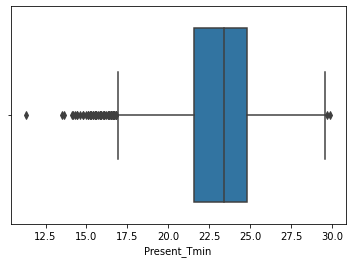

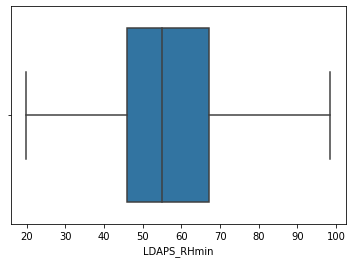

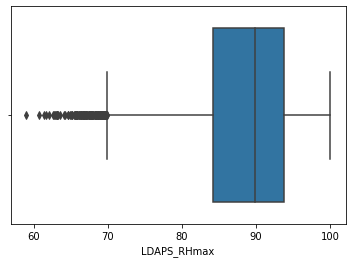

...

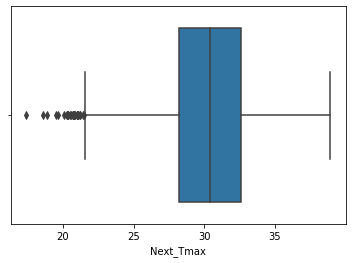

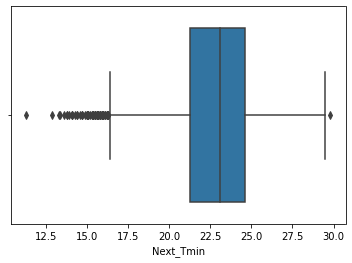

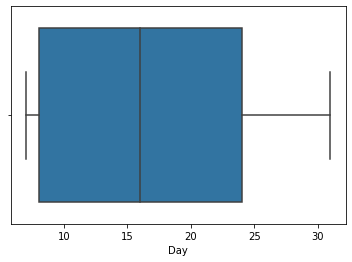

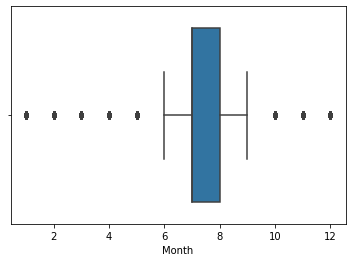

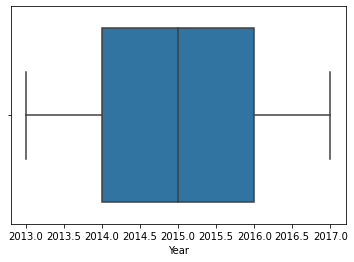

In [87]:
for i in numeric_col:
    plt.figure()
    sns.boxplot(df[i])   # Only few outliers are present in the newpaper column
    
# LDAPS_PPT4
# LDAPS_PPT3
# LDAPS_PPT2
# LDAPS_PPT1

In [88]:
# Station: No outliers present in this columns
# Present_Timax: This column containing few outliers
# Presnt_Tmin : This column containing few outliers

# LDAPS_RHmax, LDAPS_Tmax_lapse, LDAPS_Tmin_lapse, LDAPS_WS, LDAPS_LH, LDAPS_PPT1, LDAPS_PPT2, LDAPS_PPT3, LDAPS_PPT4, DEM, Slope,
# Next_Timax, Next_Tmin, Month, These mentioned columns are containing outliers, try to remove these outliers   

# Skewness Analysis

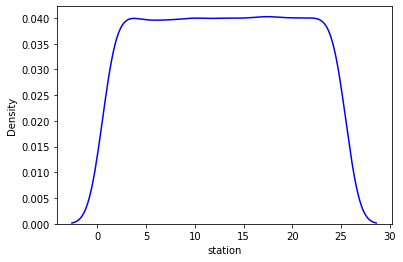

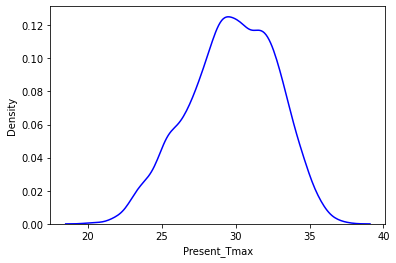

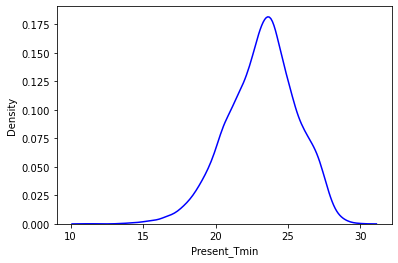

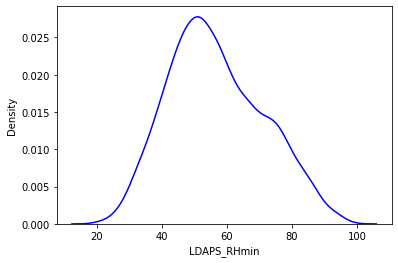

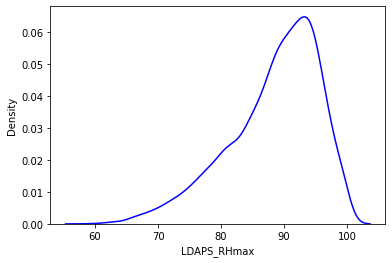

...

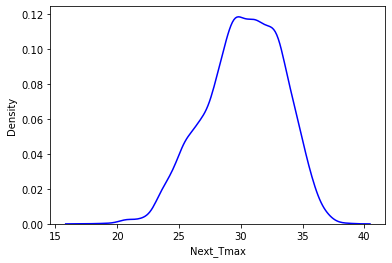

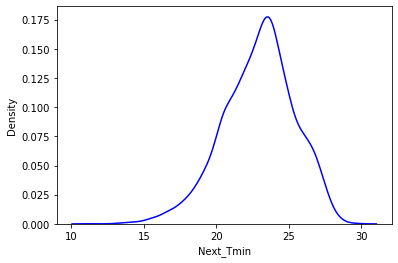

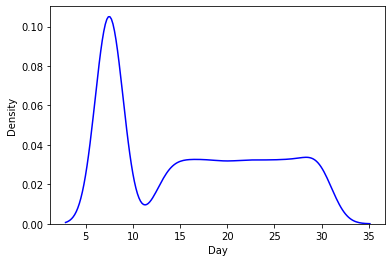

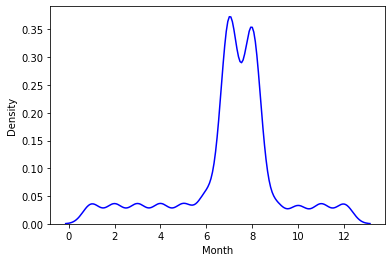

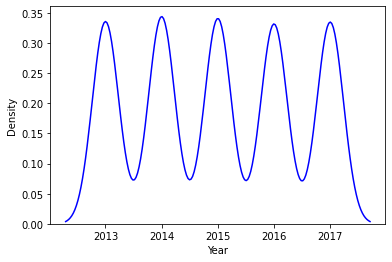

In [89]:
for i in numeric_col:
    plt.figure()
    sns.distplot(df[i], color = 'b', hist = False ) 

In [90]:

# Month: Right Skewed
# Day: Right Skewed
# Slop: Right skewed
# DEM: Right Skewed
# Next_Tmin: Left Skewed
# Next_Tmax: Left Skewed
# Solar_radiation: Left Skewed
# Ion: Left skewed
# LDPAS_CC4: Right skewed
# LDPAS_CC3: Right skewed
# LDPAS_CC2: Right skewed
# LDPAS_CC1: Right skewed
# LAPS_LH: little bit Right skewed
# LDAPS_WS: Littel bit right skewed
# LDAPS_Tmin_lapse: Little bit left skewed
# LDAPS_RHmax: Little bit left skewed

## Checking the distribution of the continuous value of the columns

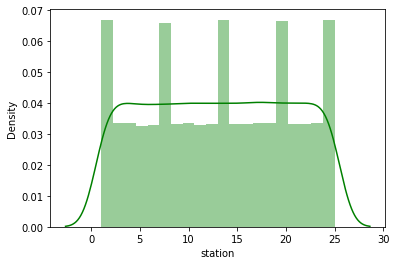

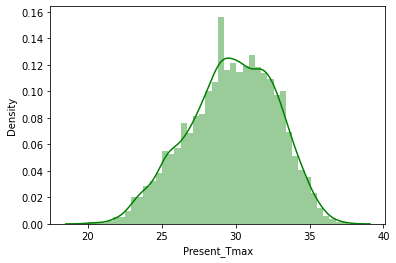

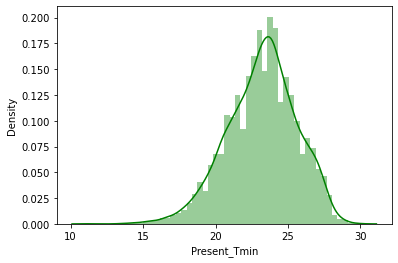

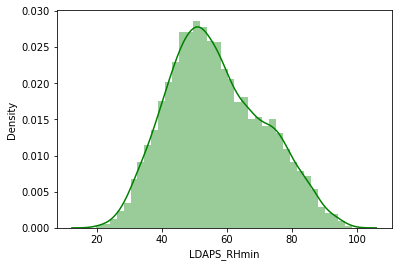

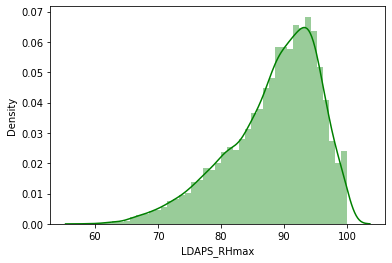

...

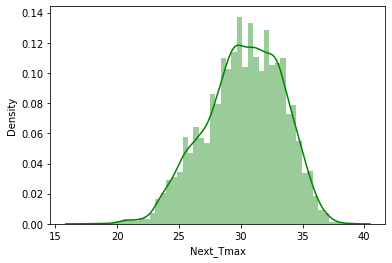

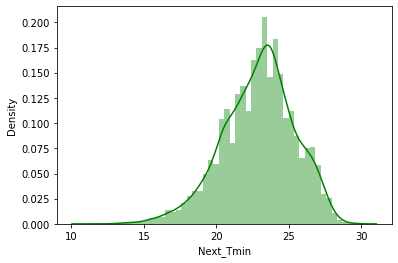

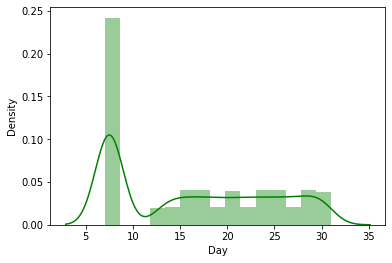

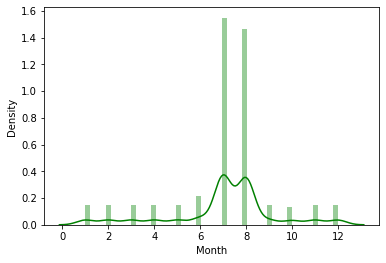

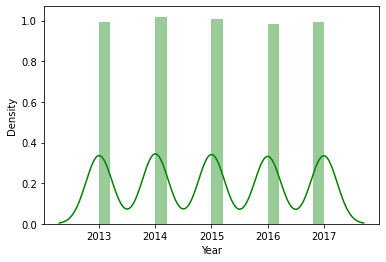

In [91]:
for i in numeric_col:
    plt.figure()
    sns.distplot(df[i], color = 'g', kde = True)

In [92]:
# only few columns are present in the dataset which is normally distributed,
# LDAPS_Tmax_lapse column is almost normally distributed
# other than these columns, are not normmally distributed
# Year column having only 3 values, 2013, 2014, 2015, 2016, 2017
# In Next_tmin column maxmimum values are lying in the range of 15 to 30
# In Next_tmax column maxmimum values are lying in the range of 20 to 38
# Solar Radiation column is on peack at 5800 approx
# In the LDAPS_PPT4, LDAPS_PPT3, LDAPS_PPT2 and LDAPS_PPT1 column is having maximum values as zero, 
# LDAPS_WS is at peak on 7 
# LDAPS_Tmin_lapse is showing peack between 22.5 to 25.0
# LDAPS_Tmax_lapse is showing peack between 28 to 32
# Maximum value for LDAPS_RHmax column is 100

## Checking the spread of the columns 

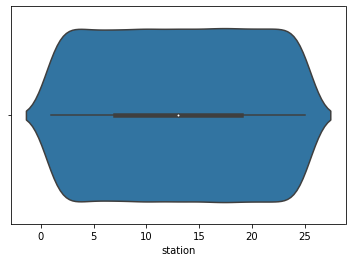

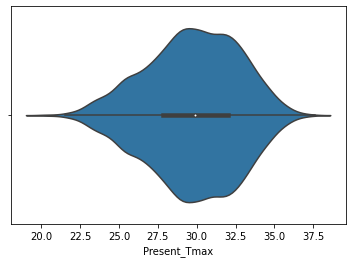

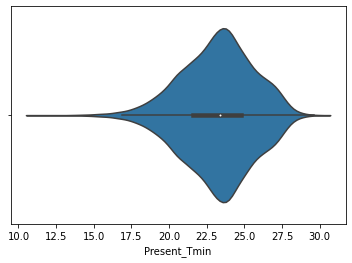

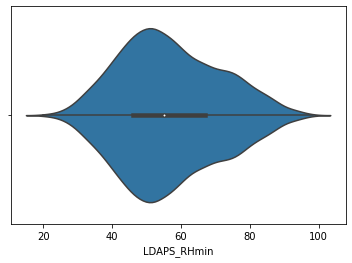

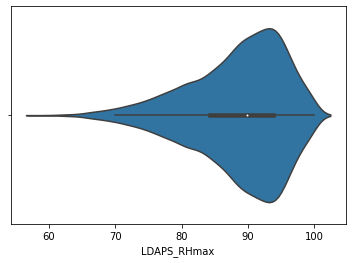

...

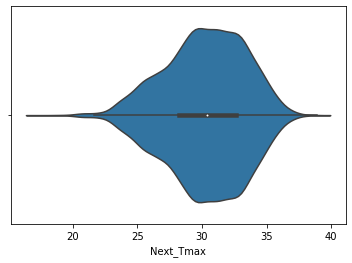

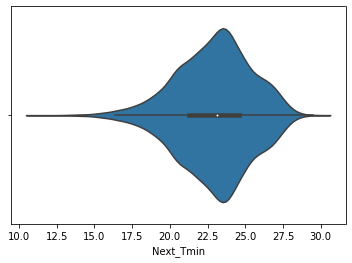

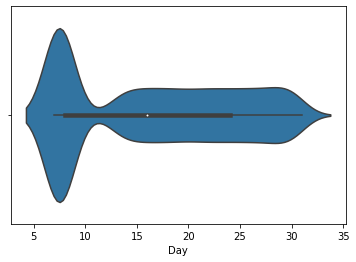

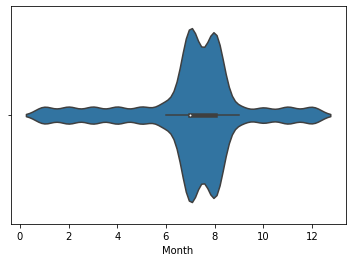

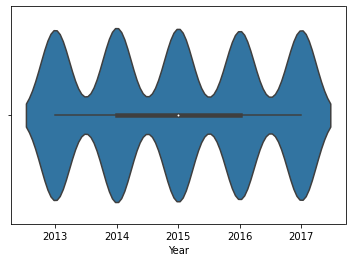

In [93]:
for i in df.columns:    
    plt.figure()
    sns.violinplot(df[i], orient = 'vertical')

In [94]:
# Present_Tmin showing outliers and not much spreaded
# LDAPS_RHmax showiing outliers and not much spreaded
# LDAPS_PPT1,2,3, 4 are containing so much outlier as these columns are having maximum value as zero
# DEM, slope , solar radiation are not much spreaded

## Checking pattern of data, how they are connected with each other

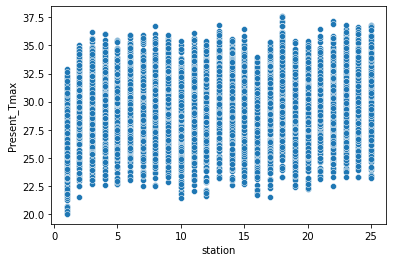

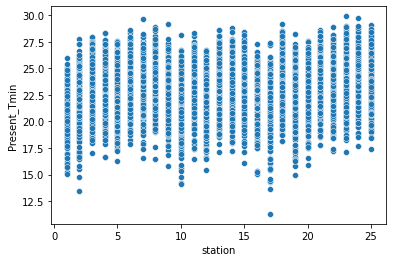

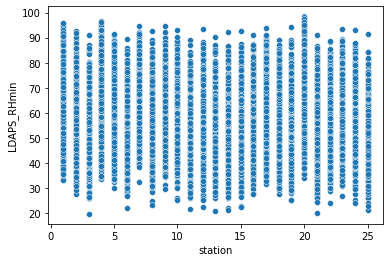

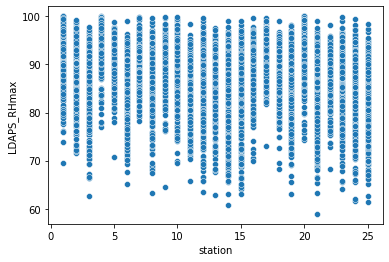

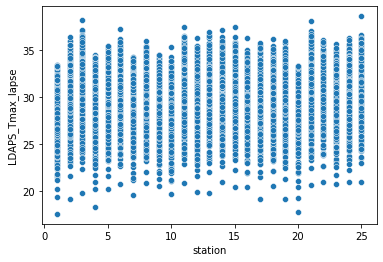

...

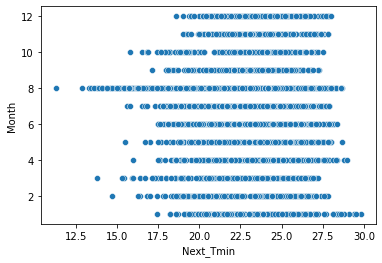

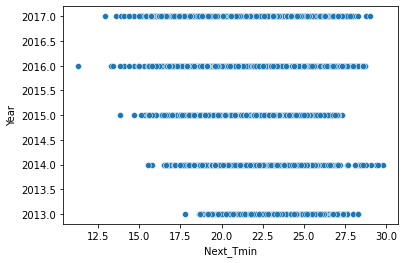

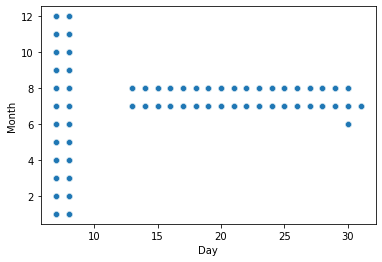

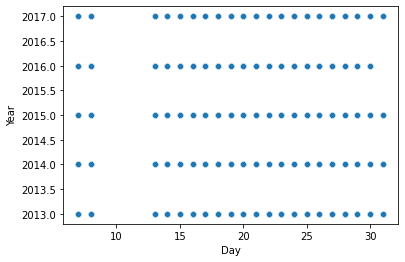

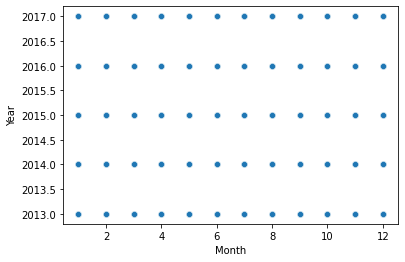

In [95]:
for i in range(len(df.columns)):

    for j in df.columns[i+1:]:    
        plt.figure()
        sns.scatterplot(df[df.columns[i]], df[j])

In [96]:
# Linear relation found between LDAS_Tmax_lapse and Present_Tmax
# Linear relation found between LDAS_Tmax_lapse and Present_Tmax
# Linear relation found between LDAS_Tmax_lapse and Present_Tmin
# Linear relation found between LDAS_Tmax_lapse and Present_Tmin
# Linear Relation found between Next_Tmax and Present_Tmax
# Linear Relation found between Next_Tmin and Present_Tmin
# Next_Tmax, and Present_Tmax
# LDAPS_RHmax and LDAPS_RHmin columns are showing linear Relation
# LDAPS_RHmin and LDAPS_RHmin columns are showing linear Relation
# These metioned columns are showing linear relation with each other

In [3]:
# for i in df.columns:    
#     plt.figure()
#     sns.scatterplot(x = df['Next_Tmax'], y = df[i])

# due to heavy file , it was unable to upload

In [1]:
# for i in df.columns:    
#     plt.figure()
#     sns.scatterplot(x = df['Next_Tmin'], y = df[i])

#this cell code is increasing file thats why i commented it

In [99]:
# Present_Tmax, Present_Tmin, LDAPS_Tmax_lapse, LDAPS_Tmin_lapse, Next_max
# These above mentioned columns are showing linear relation with target variable

## Correlation of the columns

In [100]:
df.corr()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
station,1.000000,0.113301,0.133282,-0.067846,-0.169351,0.069856,0.105277,0.005822,-0.132129,0.006539,0.003526,-0.000161,0.005005,-0.001954,-0.007635,-0.013865,-0.011085,-0.239118,-0.118845,-0.256706,-0.091721,-0.021194,0.107747,0.128184,-0.000996,0.001211,0.001474
Present_Tmax,0.113301,1.000000,0.615208,-0.209059,-0.306943,0.573777,0.628705,-0.125952,0.134246,-0.316333,-0.216976,-0.146391,-0.143069,-0.114917,-0.104779,-0.127248,-0.107295,-0.054134,0.007695,-0.189439,-0.107079,-0.022114,0.610357,0.621048,-0.154366,-0.003266,0.056002
Present_Tmin,0.133282,0.615208,1.000000,0.122200,-0.018576,0.467904,0.772061,-0.038779,-0.012817,0.084348,0.090038,-0.004719,-0.046694,0.111577,0.066207,-0.052428,-0.070391,-0.081417,-0.045174,-0.254084,-0.148423,0.059765,0.463523,0.796975,-0.115693,-0.010210,0.037457
LDAPS_RHmin,-0.067846,-0.209059,0.122200,1.000000,0.578358,-0.569580,0.085237,0.289422,-0.072195,0.612831,0.744774,0.688069,0.513937,0.259039,0.389572,0.237512,0.167311,0.085027,-0.077590,0.100684,0.122454,0.242168,-0.446824,0.093249,-0.063464,-0.053499,-0.002147
LDAPS_RHmax,-0.169351,-0.306943,-0.018576,0.578358,1.000000,-0.377293,-0.118965,0.131269,0.238986,0.435937,0.390620,0.224734,0.127242,0.268019,0.227581,0.132436,0.118101,0.194820,0.025563,0.176557,0.219436,0.146622,-0.289788,-0.076415,-0.012226,-0.039424,-0.144286
LDAPS_Tmax_lapse,0.069856,0.573777,0.467904,-0.569580,-0.377293,1.000000,0.653425,-0.316011,0.043663,-0.440878,-0.525380,-0.542728,-0.429739,-0.115659,-0.248369,-0.193749,-0.170415,-0.044052,0.091568,-0.181433,-0.163891,0.047414,0.835729,0.589963,-0.161320,-0.022279,0.020308
LDAPS_Tmin_lapse,0.105277,0.628705,0.772061,0.085237,-0.118965,0.653425,1.000000,-0.134652,-0.139675,0.008714,0.046537,-0.044998,-0.079536,0.034956,-0.002743,-0.093116,-0.103541,-0.099452,-0.024703,-0.198396,-0.187864,0.157763,0.592119,0.886513,-0.176772,-0.027050,-0.000564
LDAPS_WS,0.005822,-0.125952,-0.038779,0.289422,0.131269,-0.316011,-0.134652,1.000000,0.004427,0.285349,0.257226,0.238155,0.218870,0.141503,0.181634,0.147199,0.134428,0.033025,-0.063009,0.188540,0.169223,0.120630,-0.351107,-0.102021,-0.028312,-0.082267,-0.114114
LDAPS_LH,-0.132129,0.134246,-0.012817,-0.072195,0.238986,0.043663,-0.139675,0.004427,1.000000,-0.148314,-0.265382,-0.246709,-0.173156,-0.018708,-0.084375,0.009495,0.012372,0.133309,0.024476,0.056362,0.087517,-0.044956,0.156779,-0.060392,-0.010504,-0.024944,0.055898
LDAPS_CC1,0.006539,-0.316333,0.084348,0.612831,0.435937,-0.440878,0.008714,0.285349,-0.148314,1.000000,0.779510,0.516698,0.362670,0.446930,0.389368,0.166763,0.088897,-0.010268,-0.007962,-0.017378,-0.023893,0.218285,-0.459705,-0.012877,-0.018974,-0.076819,-0.066233


<AxesSubplot:>

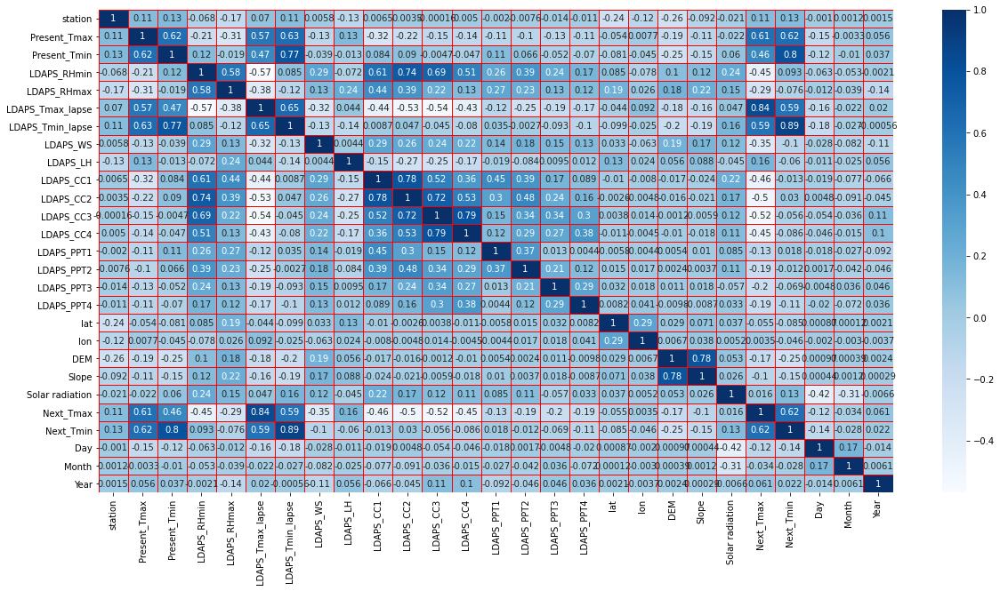

In [101]:
plt.figure(figsize = (20,10))
sns.heatmap(df.corr(), annot = True, cmap = 'Blues', linewidth = 0.5, linecolor = 'red')

In [102]:
# Next_Tmin and Present_Tmin are highly correlated 
# Next_Tmax and LDAPS_Tmax_lapse are highly correlated
# Next_Tmin and LDAPS_Time_Lapse are highly correlated

## Describe Data

In [103]:
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
count,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.00000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000
mean,13.014101,29.748366,23.195809,56.724969,88.360823,29.620128,23.511786,7.094097,62.492606,0.368510,0.355528,0.317546,0.298268,0.589008,0.480738,0.275007,0.265373,37.544792,126.99142,61.918136,1.259755,5343.724208,30.241526,22.910820,16.337375,7.068134,2014.991697
std,7.217858,2.967401,2.400880,14.626559,7.199456,2.943496,2.342579,2.177034,33.686158,0.262260,0.257922,0.249833,0.253392,1.927577,1.743327,1.146087,1.179661,0.050428,0.07922,54.323529,1.372748,429.782561,3.111807,2.482256,8.216880,2.242389,1.410877
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,37.456200,126.82600,12.370000,0.098500,4329.520508,17.400000,11.300000,7.000000,1.000000,2013.000000
25%,7.000000,27.800000,21.600000,45.960243,84.203724,27.673756,22.086820,5.675358,37.206201,0.146546,0.140324,0.100950,0.081495,0.000000,0.000000,0.000000,0.000000,37.510200,126.93700,28.700000,0.271300,5001.485717,28.200000,21.300000,8.000000,7.000000,2014.000000
50%,13.000000,29.900000,23.400000,55.023199,89.784122,29.709537,23.758249,6.547838,56.898324,0.315706,0.311676,0.261795,0.227459,0.000000,0.000000,0.000000,0.000000,37.550700,126.99500,45.716000,0.618000,5441.987305,30.400000,23.100000,16.000000,7.000000,2015.000000
75%,19.000000,32.000000,24.800000,67.115099,93.742725,31.711109,25.155660,8.028960,84.235666,0.574174,0.557164,0.496444,0.498127,0.052594,0.017735,0.007855,0.000017,37.577600,127.04200,59.832400,1.767800,5729.485840,32.600000,24.600000,24.000000,8.000000,2016.000000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,0.968353,0.983789,0.974710,23.701544,21.621661,15.841235,16.655469,37.645000,127.13500,212.335000,5.178200,5992.895996,38.900000,29.800000,31.000000,12.000000,2017.000000


<AxesSubplot:>

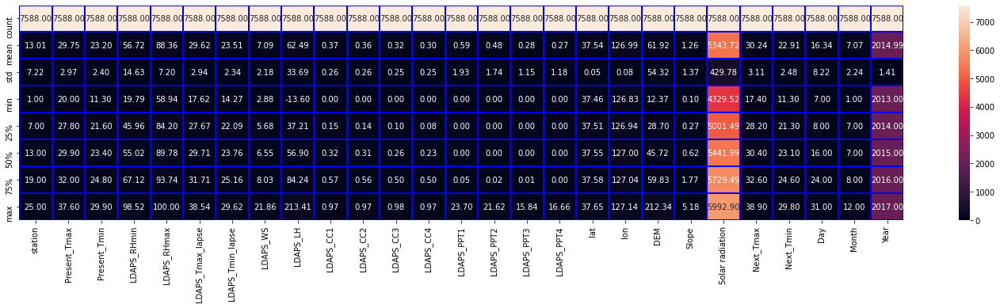

In [104]:
plt.figure(figsize = (25, 5))
sns.heatmap(df.describe(), annot = True, linewidth = 0.05, linecolor = 'blue', fmt = "0.2f")

In [105]:
# LDAPS_WS, LDAPS_CC3, LDAPS_CC4, LDAPS_PPT1,2,3,4 DEM, Slope are showig high difference between mean value and 50 percentile 
# value, mean containing high number of outliers and these column are skewed too.

# Min value is zero only for LDAPS_PPT1,2,3,4 columns

In [106]:
df.columns


Index(['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin', 'Day', 'Month', 'Year'],
      dtype='object')

## Checking the columns which are positively and negatively correlated with the target columns

In [107]:
df1 = df.drop(columns = ['Next_Tmin'])
df2 = df.drop(columns = 'Next_Tmax')

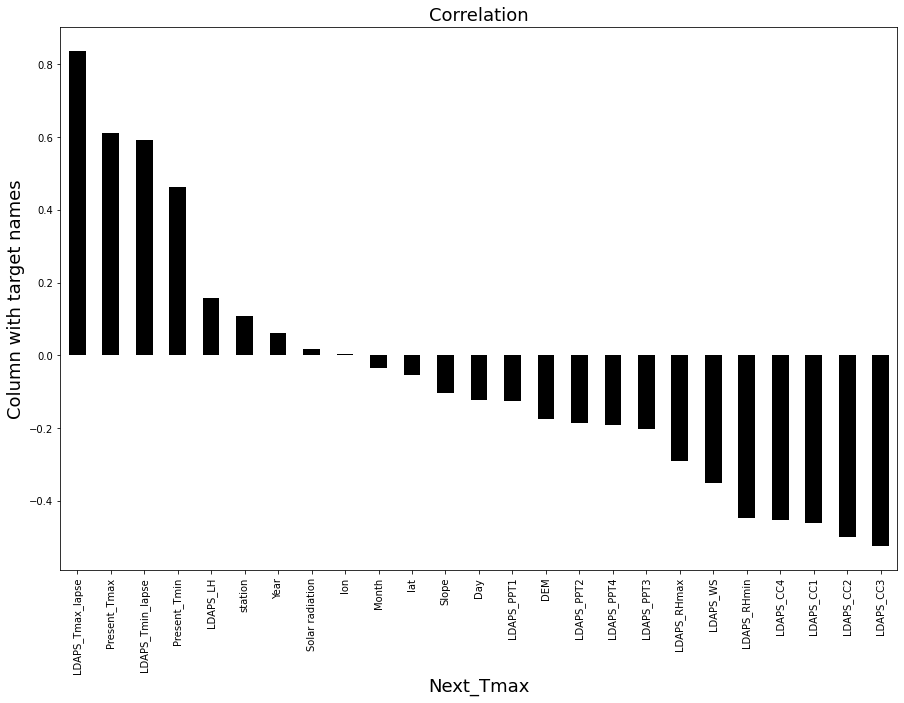

In [108]:
plt.figure(figsize = (15, 10))
one = df1.corr()['Next_Tmax'].sort_values(ascending = False)
one .drop(['Next_Tmax']).plot(kind = 'bar', color = 'black')
plt.xlabel('Next_Tmax', fontsize = 18)
plt.ylabel('Column with target names', fontsize = 18)
plt.title('Correlation', fontsize = 18)
plt.show()

In [109]:
# For target (Next_Tmax) 
# Highly impacting Positively to the target varaible:
# LDAPS_Tmax, Prsent_Tmax, LDAPS_Tmin_lapse

# Hightly Impacting Negatively to the target variable:
# LDAPS_CC3, LDAPS_CC2, LDAPS_CC1 columns

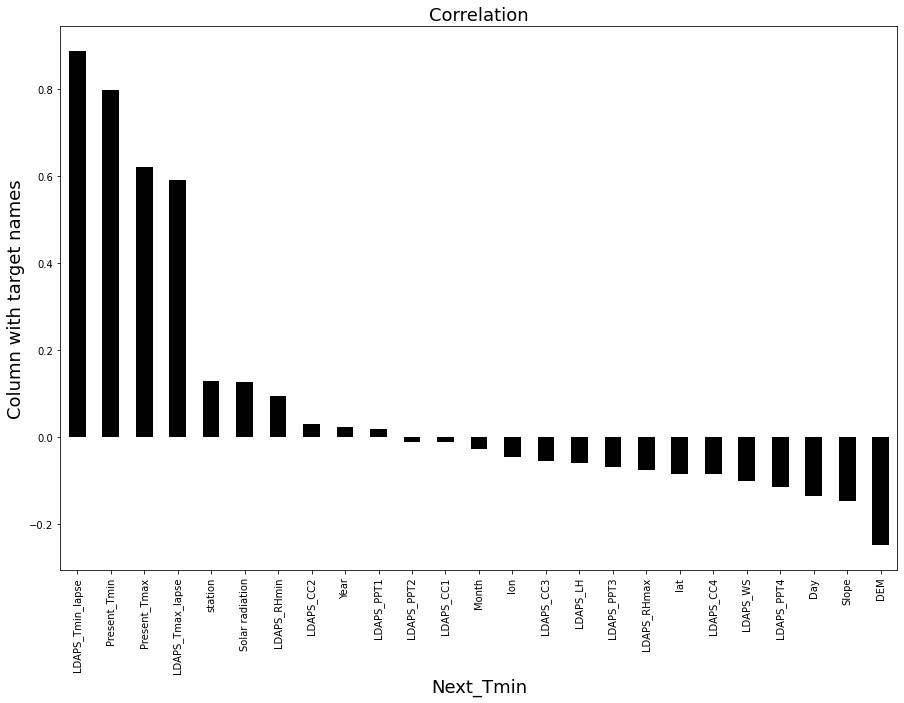

In [110]:
plt.figure(figsize = (15, 10))
one = df2.corr()['Next_Tmin'].sort_values(ascending = False)
one .drop(['Next_Tmin']).plot(kind = 'bar', color = 'black')
plt.xlabel('Next_Tmin', fontsize = 18)
plt.ylabel('Column with target names', fontsize = 18)
plt.title('Correlation', fontsize = 18)
plt.show()

In [111]:
# For target (Next_Tmin) 
# Highly Positively impacting  to the target varaible:
# LDAPS_Tmin_lapse, Prsent_Tmin, Prsent_Tmax

# Hightly  Negatively Impacting to the target variable:
# DEM, Slope, Year columns

In [113]:
# sns.pairplot(df)
df.columns

Index(['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin', 'Day', 'Month', 'Year'],
      dtype='object')

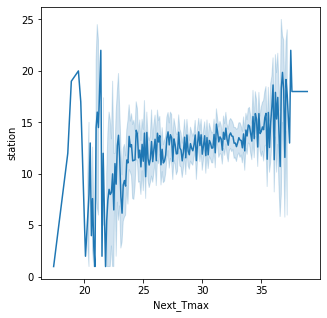

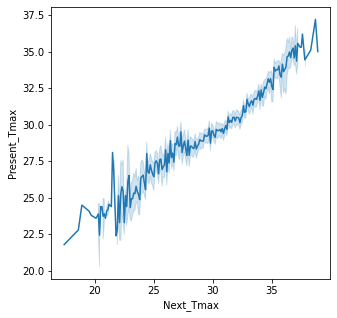

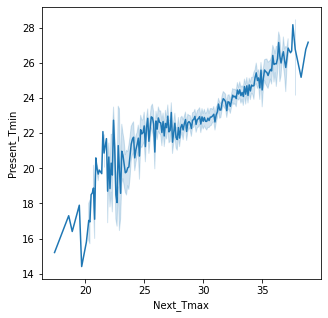

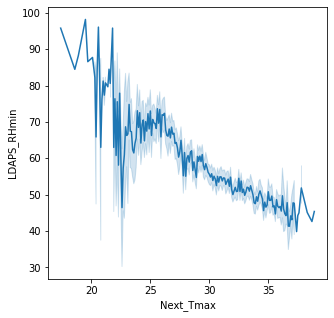

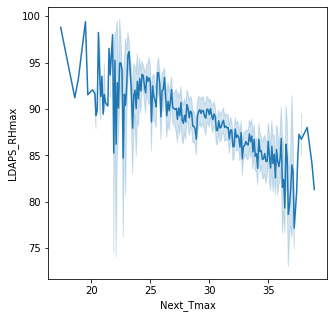

...

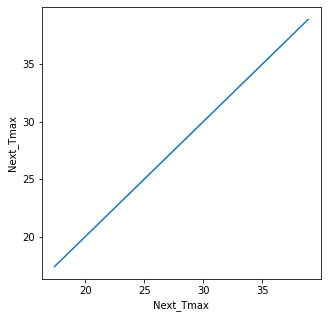

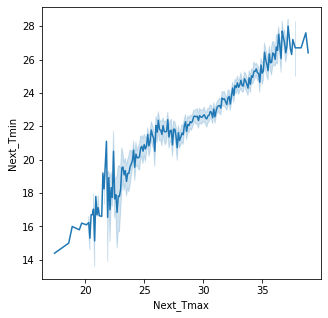

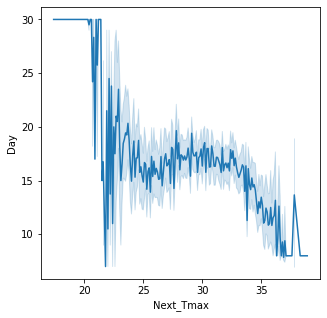

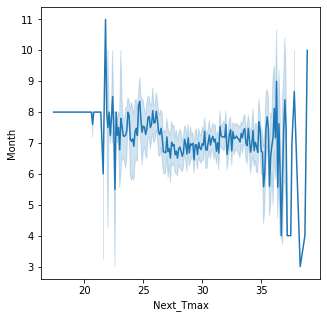

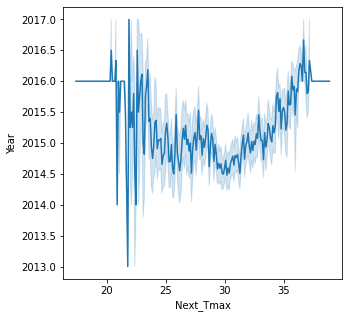

In [120]:
for i in numeric_col:
    plt.figure(figsize = (5, 5))
    sns.lineplot(x = 'Next_Tmax', y = i, data = df)
    plt.show()
    

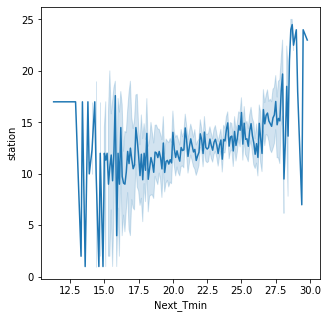

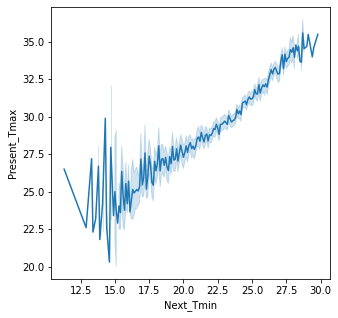

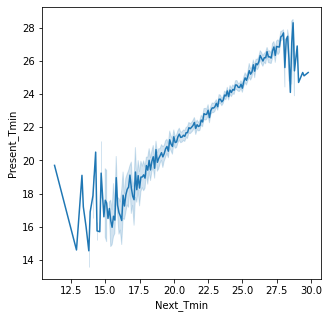

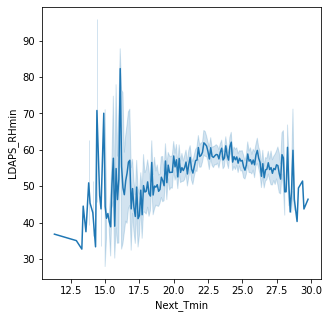

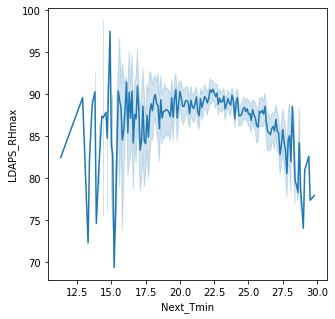

...

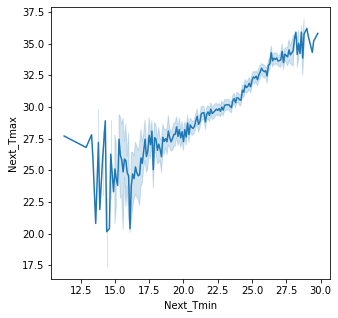

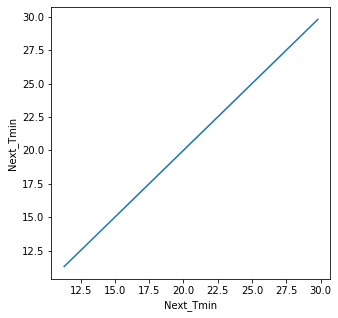

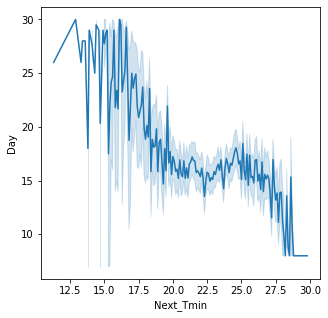

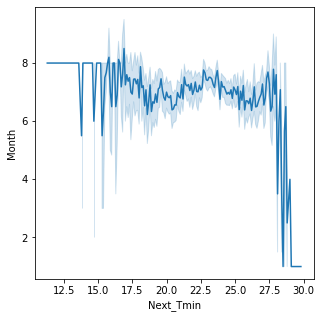

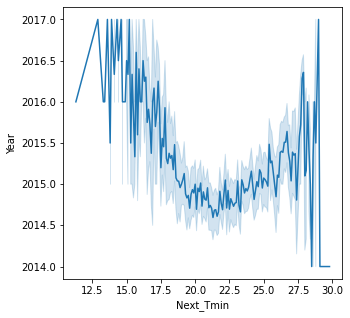

In [121]:
for i in numeric_col:
    plt.figure(figsize = (5, 5))
    sns.lineplot(x = 'Next_Tmin', y = i, data = df)
    plt.show()
    

## Removing Outlier

In [122]:
from scipy.stats import zscore

In [123]:
z = np.abs(zscore(df))
df_z = df[ (z<3).all(axis = 1)]  # operation to remove outliers

In [124]:
df_z.shape   # (6739, 27)

(6739, 27)

In [125]:
(df.shape[0]  - df_z.shape[0] ) / df.shape[0]  *100     
# We can not impliment this method because this method is giving high loss of data
# 11.188719030047443 %

11.188719030047443

In [126]:
# IQR method to remove outliers
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1 

In [128]:
df_IQR = df[~((df < (Q1 - 1.5*IQR) ) | (df > (Q3 + 1.5*IQR) )).any(axis = 1) ] 
df_IQR.shape   
# can not use this method too, as it is also giving high loss of data.
# (2371, 27)

(2371, 27)

In [129]:
((df1.shape[0] - df_IQR.shape[0] ) / df1.shape[0] ) * 100

# 68.7532946758039 % data loss is occuring bt this method

68.7532946758039

In [74]:
# Both methods are giving high loss of data therefor we will leave data as it is and will apply proceedings to the existing data

## Seperate data into x and y form

In [130]:
x = df.drop(columns = ['Next_Tmax', 'Next_Tmin'])
ymax = df['Next_Tmax']
ymin = df['Next_Tmin']

print(x.shape)
print(ymax.shape)
print(ymin.shape)

# (7588, 25)
# (7588,)
# (7588,)

(7588, 25)
(7588,)
(7588,)


## Removing skewness (if present)

In [131]:
x.skew()

station            -0.004178
Present_Tmax       -0.257069
Present_Tmin       -0.353822
LDAPS_RHmin         0.301396
LDAPS_RHmax        -0.845264
LDAPS_Tmax_lapse   -0.222349
LDAPS_Tmin_lapse   -0.574035
LDAPS_WS            1.553926
LDAPS_LH            0.662971
LDAPS_CC1           0.456716
LDAPS_CC2           0.473929
LDAPS_CC3           0.639649
LDAPS_CC4           0.663815
LDAPS_PPT1          5.305906
LDAPS_PPT2          5.710360
LDAPS_PPT3          6.356670
LDAPS_PPT4          6.681256
lat                 0.085377
lon                -0.289048
DEM                 1.721617
Slope               1.559050
Solar radiation    -0.524325
Day                 0.245563
Month              -0.703092
Year                0.013575
dtype: float64

In [132]:
skewness = x.skew() 
skewness[skewness > 0.5].keys()

Index(['LDAPS_WS', 'LDAPS_LH', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'DEM', 'Slope'],
      dtype='object')

In [133]:
skewness2 = x.skew() 
skewness2[skewness2 < -0.5].keys()

Index(['LDAPS_RHmax', 'LDAPS_Tmin_lapse', 'Solar radiation', 'Month'], dtype='object')

In [134]:
positive_skewed = skewness[skewness > 0.5].keys()
negative_skewed = skewness2[skewness2 < -0.5].keys()

In [135]:
skewed = ['LDAPS_WS', 'LDAPS_LH', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'DEM',
          'Slope', 'LDAPS_RHmax', 'LDAPS_Tmin_lapse', 'Solar radiation']
skewed

['LDAPS_WS',
 'LDAPS_LH',
 'LDAPS_CC3',
 'LDAPS_CC4',
 'LDAPS_PPT1',
 'LDAPS_PPT2',
 'LDAPS_PPT3',
 'LDAPS_PPT4',
 'DEM',
 'Slope',
 'LDAPS_RHmax',
 'LDAPS_Tmin_lapse',
 'Solar radiation']

In [136]:
from sklearn.preprocessing import PowerTransformer
pt = PowerTransformer('yeo-johnson')

In [137]:
x[skewed] = pt.fit_transform(x[skewed])
# applying to skewed columns of dataset

In [142]:
x[skewed].skew()

# LDAPS_WS            0.005937
# LDAPS_LH            0.028141
# LDAPS_CC3           0.091156
# LDAPS_CC4           0.129974
# LDAPS_PPT1          1.451770
# LDAPS_PPT2          1.637689
# LDAPS_PPT3          1.814526
# LDAPS_PPT4          2.041426
# DEM                 0.039591
# Slope               0.233968
# LDAPS_RHmax        -0.120174
# LDAPS_Tmin_lapse   -0.021647
# Solar radiation    -0.182349

# LDAPS_PPT1, LDAPS_PPT2, LDAPS_PPT3, LDAPS_PPT4 columns are having maximum values as zero, therefore still some 
# skewnwss present in this columns

LDAPS_WS            0.005937
LDAPS_LH            0.028141
LDAPS_CC3           0.091156
LDAPS_CC4           0.129974
LDAPS_PPT1          1.451770
LDAPS_PPT2          1.637689
LDAPS_PPT3          1.814526
LDAPS_PPT4          2.041426
DEM                 0.039591
Slope               0.233968
LDAPS_RHmax        -0.120174
LDAPS_Tmin_lapse   -0.021647
Solar radiation    -0.182349
dtype: float64

In [140]:
# Now, all value of skew for each column is under the acceptable range of skewness

## Removing Multicollinearity

#### Using VIF (Variance Inflation factor)

In [143]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [144]:
def vif_cal(data):   # function to calculate vif
    vif = pd.DataFrame()
    vif['Features'] = x.columns
    vif['VIF'] = [variance_inflation_factor(x.values, i) for i in range(data.shape[1])]
    return vif

In [145]:
vif_cal(x)


,Features,VIF
0,station,5.425738e+00
1,Present_Tmax,2.917393e+02
2,Present_Tmin,2.993782e+02
3,LDAPS_RHmin,1.042487e+02
4,LDAPS_RHmax,2.679402e+00
5,LDAPS_Tmax_lapse,7.153056e+02
6,LDAPS_Tmin_lapse,6.805196e+00
7,LDAPS_WS,1.262936e+00
8,LDAPS_LH,1.496111e+00
9,LDAPS_CC1,1.526923e+01


In [146]:
# As we can see lat and lon column is shwoing high vif value e+05, it is also contributing less to predict target variable
x.drop(columns = ['lat', 'lon' ], inplace = True)

In [147]:
vif_cal(x)

,Features,VIF
0,station,5.151015
1,Present_Tmax,289.232947
2,Present_Tmin,296.649042
3,LDAPS_RHmin,103.121684
4,LDAPS_RHmax,2.534408
5,LDAPS_Tmax_lapse,706.042796
6,LDAPS_Tmin_lapse,6.763841
7,LDAPS_WS,1.252438
8,LDAPS_LH,1.484114
9,LDAPS_CC1,15.267504


In [148]:
# Present_Tmax
# Present_Tmin
# LDAPS_Tmax_lapse
# These columns are showing high vif value but we can not delete these column because it is highly impacting to predict target 
# variable as we can seen below

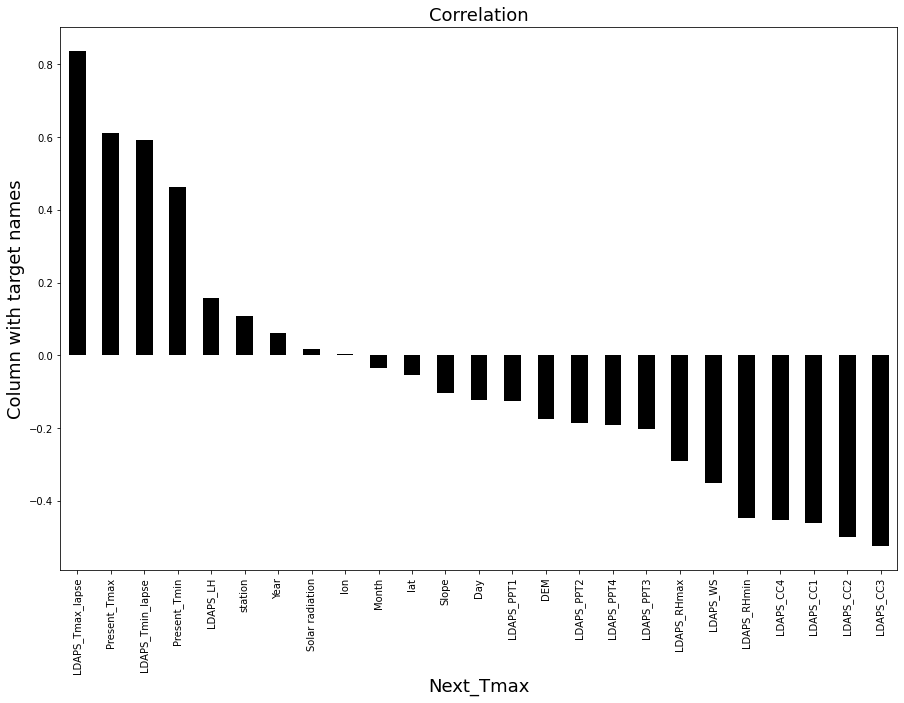

In [150]:
plt.figure(figsize = (15, 10))
one = df1.corr()['Next_Tmax'].sort_values(ascending = False)
one .drop(['Next_Tmax']).plot(kind = 'bar', color = 'black')
plt.xlabel('Next_Tmax', fontsize = 18)
plt.ylabel('Column with target names', fontsize = 18)
plt.title('Correlation', fontsize = 18)
plt.show()

## Standard Scaling

In [151]:
from sklearn.preprocessing import StandardScaler
ss = StandardScaler()

In [152]:
x_scaler = ss.fit_transform(x)  # fitting and transforming the x dataset
x = pd.DataFrame(x_scaler, columns = x.columns)

## Apply Machine Learning  ymax

In [154]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import cross_val_score

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeRegressor

In [155]:
def best_randomstate (model, x, y):
    best_fit = []
    for i in range(0, 200 ) :
        x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.30, random_state = i)
        m = model()
        m.fit(x_train, y_train)
        m_predict_train = m.predict(x_train)
        m_predict_test = m.predict(x_test)

        training = r2_score(m_predict_train, y_train)
        testing = r2_score(m_predict_test, y_test)

#         print('At random state', i, 'the training accuracy is :', training)
#         print('At random state', i, 'the testing accuracy is :', testing) 
#         print('\n')

        if np.abs(round(training, 2) - round(testing, 2)) < 0.01:
            best_fit.append(i)
    return (best_fit)

In [156]:
def check_model (model, x, y, r_list):
    for i in r_list :
        x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.30, random_state = i)
        m = model()
        m.fit(x_train, y_train)
        m_predict_train = m.predict(x_train)
        m_predict_test = m.predict(x_test)

        training = r2_score(m_predict_train, y_train)
        testing = r2_score(m_predict_test, y_test)

        print('At random state', i, 'the training r2_score is :', training)
        print('At random state', i, 'the testing r2_score is :', testing) 
        print('_________________________________________________________________')

In [157]:
def train(algo, x, y, best_fit):
    # train the model
    model = algo()
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.30, random_state = best_fit)
    model.fit(x_train, y_train)
    
    # predict the training set
    m_predict_train = model.predict(x_train)
    m_predict_test = model.predict(x_test)
    
    training = r2_score(m_predict_train, y_train)
    testing = r2_score(m_predict_test, y_test)

    print('Training r2_score is :', training)
    print('Testing r2_score is :', testing) 
    
    print('__________________________________________________________________')
    print('Mean Squared Error: ', mean_squared_error(m_predict_test, y_test) )
    print('Mean Absolute error: ', mean_absolute_error(m_predict_test, y_test) )
    print('___________________________________________________________________')
#     print('Cross value score')
    
# #     # perform cross-validation
# #     for i in range(3, 12):
# #         cv_score = cross_val_score(model, x, y, cv = i ).mean()
# #         print('cv score',  cv_score ,'at', i, 'cross fold')

    plt.figure(figsize = (10, 5))
    plt.scatter(x = y_test, y = m_predict_test, color = 'r')
    plt.plot(y_test, y_test, color = 'g')
    plt.xlabel('Actual', fontsize= 18 )
    plt.ylabel('Predicted', fontsize = 18)
    plt.title(str(algo), fontsize = 20)


In [158]:
# max_acc1 = 0
# random_s1 = 0

# for i in range(200):
#     x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.30, random_state = i)
#     model1 = LinearRegression()
#     model1.fit(x_train, y_train)
#     model1_predict = model1.predict(x_test)
#     acc = r2_score(model1_predict, y_test)
    
#     if acc > max_acc1:
#         max_acc1 = acc
#         random_s1 = i
# print('Model is giving best accurancy', max_acc1, 'on random state of', random_s1 )

# # Model is giving best accurancy 0.9288123541245199 on random state of 115

### Model 1:  LinearRegression

In [160]:
best_fit1 = best_randomstate(LinearRegression, x, ymax)
print(best_fit1)

[1, 2, 9, 17, 21, 28, 33, 37, 42, 51, 52, 61, 66, 69, 75, 76, 82, 86, 87, 94, 97, 98, 100, 108, 109, 112, 115, 117, 127, 128, 130, 136, 137, 141, 143, 150, 155, 158, 159, 163, 167, 171, 173, 174, 175, 176, 178, 180, 181, 182, 193]


In [161]:
check_model (LinearRegression, x, ymax, best_fit1)

At random state 1 the training r2_score is : 0.7102507934698818
At random state 1 the testing r2_score is : 0.712531433773996
_________________________________________________________________
At random state 2 the training r2_score is : 0.7119316682056821
At random state 2 the testing r2_score is : 0.706473733882022
_________________________________________________________________
At random state 9 the training r2_score is : 0.7084900721231877
At random state 9 the testing r2_score is : 0.7089310767460297
_________________________________________________________________
At random state 17 the training r2_score is : 0.7087683762023798
At random state 17 the testing r2_score is : 0.7125084073731789
_________________________________________________________________
At random state 21 the training r2_score is : 0.7062933650043772
At random state 21 the testing r2_score is : 0.7144674127979442
_________________________________________________________________
At random state 28 the training r

Training r2_score is : 0.7130837724090549
Testing r2_score is : 0.7129458306574417
__________________________________________________________________
Mean Squared Error:  2.192867834336501
Mean Absolute error:  1.1208785467576654
___________________________________________________________________


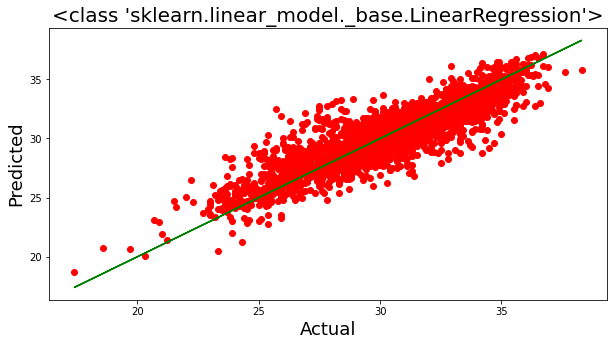

In [162]:
train (LinearRegression, x, ymax, 171)

In [163]:
for val in range (2, 10):
    cv = cross_val_score(LinearRegression(), x, ymax, cv = val).mean()
    print('cv score is', cv, 'at cross fold value', val)

cv score is 0.5729074231439999 at cross fold value 2
cv score is 0.6771422946192424 at cross fold value 3
cv score is 0.6846595815425205 at cross fold value 4
cv score is 0.6787740945871882 at cross fold value 5
cv score is 0.6809325315765857 at cross fold value 6
cv score is 0.683730171108266 at cross fold value 7
cv score is 0.6878037873406432 at cross fold value 8
cv score is 0.6367342717880765 at cross fold value 9


In [164]:
# Training r2_score is : 0.7130837724090549
# Testing r2_score is : 0.7129458306574417
# __________________________________________________________________
# Mean Squared Error:  2.192867834336501
# Mean Absolute error:  1.1208785467576654

# giving highest cv score 0.687803 at cross fold 8

### Model 2. AdaBoostRegressor

In [165]:
from sklearn.ensemble import AdaBoostRegressor

In [166]:
best_fit2 = best_randomstate(AdaBoostRegressor, x, ymax)
print(best_fit2)

[5, 7, 17, 20, 33, 34, 38, 39, 48, 62, 66, 71, 76, 79, 103, 114, 117, 123, 134, 136, 144, 158, 161, 162, 169, 175, 177, 193, 199]


In [167]:
check_model (AdaBoostRegressor, x, ymax, best_fit2)

At random state 5 the training r2_score is : 0.6603442229131575
At random state 5 the testing r2_score is : 0.6562634482460437
_________________________________________________________________
At random state 7 the training r2_score is : 0.6467195446340179
At random state 7 the testing r2_score is : 0.6488855025606043
_________________________________________________________________
At random state 17 the training r2_score is : 0.6274012281233529
At random state 17 the testing r2_score is : 0.6177494845947142
_________________________________________________________________
At random state 20 the training r2_score is : 0.6531484252112972
At random state 20 the testing r2_score is : 0.6480208183165554
_________________________________________________________________
At random state 33 the training r2_score is : 0.6781064801086305
At random state 33 the testing r2_score is : 0.6738980942798426
_________________________________________________________________
At random state 34 the traini

Training r2_score is : 0.681661349412357
Testing r2_score is : 0.6742562047750502
__________________________________________________________________
Mean Squared Error:  2.1352777962832215
Mean Absolute error:  1.1812434979029558
___________________________________________________________________


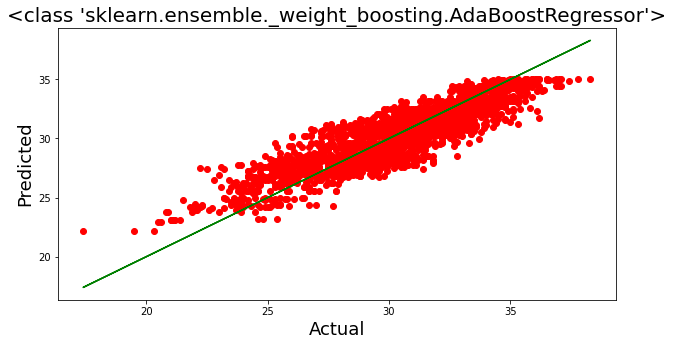

In [168]:
train (AdaBoostRegressor, x, ymax, 33)

In [172]:
for val in range (2, 8):
    cv = cross_val_score(AdaBoostRegressor(), x, ymax, cv = val).mean()
    print('cv score is', cv, 'at cross fold value', val)

cv score is 0.6178134470067207 at cross fold value 2
cv score is 0.6838229754379995 at cross fold value 3
cv score is 0.656270187073999 at cross fold value 4
cv score is 0.6807815619537907 at cross fold value 5
cv score is 0.6619415090982318 at cross fold value 6
cv score is 0.6585133788297942 at cross fold value 7


In [173]:
# Training r2_score is : 0.681661349412357
# Testing r2_score is : 0.6742562047750502
# __________________________________________________________________
# Mean Squared Error:  2.1352777962832215
# Mean Absolute error:  1.1812434979029558
# __________________________________________
# highest cv 0.683822 at cross fold 3

### Model 3. DecisionTreeRegressor 

In [174]:
from sklearn.svm import SVR
from sklearn.linear_model import ElasticNet, Lasso, Ridge
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor

In [175]:
best_fit3 = best_randomstate(DecisionTreeRegressor, x, ymax)
print(best_fit3)

[]


In [177]:
max_acc1 = 0
random_s1 = 0

for i in range(200):
    x_train, x_test, y_train, y_test = train_test_split(x, ymax, test_size = 0.30, random_state = i)
    model1 = DecisionTreeRegressor()
    model1.fit(x_train, y_train)
    model1_predict = model1.predict(x_test)
    acc = r2_score(y_test, model1_predict)
    
    if acc > max_acc1:
        max_acc1 = acc
        random_s1 = i
print('Model is giving best accurancy', max_acc1, 'on random state of', random_s1 )

Model is giving best accurancy 0.8168990170650221 on random state of 109


Training r2_score is : 1.0
Testing r2_score is : 0.8170450838971481
__________________________________________________________________
Mean Squared Error:  1.8830390865173474
Mean Absolute error:  0.994115063680281
___________________________________________________________________


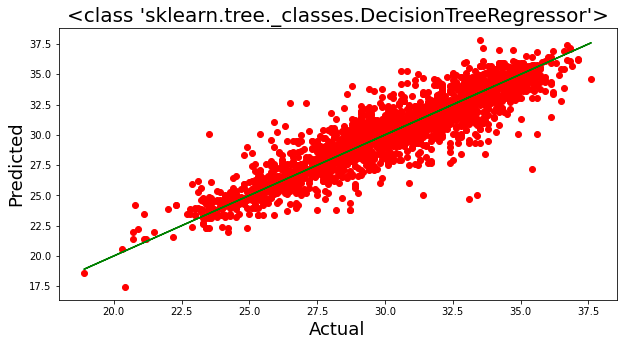

In [178]:
train (DecisionTreeRegressor, x, ymax, 109)

In [179]:
for val in range (2, 8):
    cv = cross_val_score(DecisionTreeRegressor(), x, ymax, cv = val).mean()
    print('cv score is', cv, 'at cross fold value', val)

cv score is 0.39687847681859045 at cross fold value 2
cv score is 0.4886585373337106 at cross fold value 3
cv score is 0.43176712517217153 at cross fold value 4
cv score is 0.4564654022501863 at cross fold value 5
cv score is 0.4134702402794122 at cross fold value 6
cv score is 0.41942368860406914 at cross fold value 7


In [180]:
# Training r2_score is : 1.0
# Testing r2_score is : 0.8170450838971481
# __________________________________________________________________
# Mean Squared Error:  1.8830390865173474
# Mean Absolute error:  0.994115063680281
# _________________________________________

# Highest cv 0.488658 at cross fold 3

### Model 4: SVR

In [182]:
from sklearn.svm import SVR

In [181]:
max_acc1 = 0
random_s1 = 0

for i in range(200):
    x_train, x_test, y_train, y_test = train_test_split(x, ymax, test_size = 0.30, random_state = i)
    model1 = SVR()
    model1.fit(x_train, y_train)
    model1_predict = model1.predict(x_test)
    acc = r2_score(y_test, model1_predict)
    
    if acc > max_acc1:
        max_acc1 = acc
        random_s1 = i
print('Model is giving best accurancy', max_acc1, 'on random state of', random_s1 )

Model is giving best accurancy 0.9044770092716472 on random state of 30


Training r2_score is : 0.887866469062963
Testing r2_score is : 0.8865714909897223
__________________________________________________________________
Mean Squared Error:  0.952533420374179
Mean Absolute error:  0.7411819499168814
___________________________________________________________________


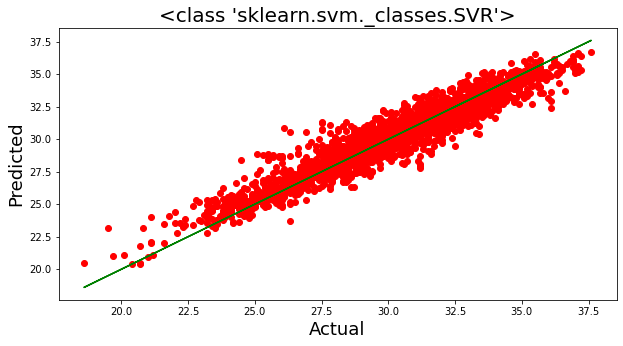

In [183]:
train (SVR, x, ymax, 30)

In [185]:
for val in range (2, 8):
    cv = cross_val_score(SVR(), x, ymax, cv = val).mean()
    print('cv score is', cv, 'at cross fold value', val)

cv score is 0.5913640704579363 at cross fold value 2
cv score is 0.6885753141013429 at cross fold value 3
cv score is 0.6365231510583917 at cross fold value 4
cv score is 0.6620428909947336 at cross fold value 5
cv score is 0.6640795990817313 at cross fold value 6
cv score is 0.6648372257793749 at cross fold value 7


In [186]:
# Training r2_score is : 0.887866469062963
# Testing r2_score is : 0.8865714909897223
# __________________________________________________________________
# Mean Squared Error:  0.952533420374179
# Mean Absolute error:  0.7411819499168814

# highest cv 0.688575 at cross value 3

In [193]:
# 	                      Accuracy of Train	       Accuracy of Test	         CV	             Difference
# LinearRegression	      0.713083	               0.712945	                0.687803	     0.025142
# AdaBoostRegressor	      0.681661	               0.674256	                0.683822	     0.009566
# DecisionTreeRegressor	  1	                       0.817045	                0.488658	     0.328387
# SVR	                  0.887866	               0.886571	                0.688575	     0.197996


# LinearRegression model is not giving overfitted or underfitted model but having cv score which is higher than AdaBoost
# AdaboostRegressor is also not giving overfitted or underfitted model and having least difference between cv and accuracy
# Decision Regressor is giving overfitted model
# SVR model is having high differenece between cv and accuracy
# therefore, we finalize AdaboostRegressor as final model for applying ensemble techniques

## Final Model (AdaBoostRegressor)

#### Ensemble Technique 

In [84]:
from sklearn.model_selection import GridSearchCV

In [373]:
x_train, x_test, y_train, y_test = train_test_split(x, ymax, test_size = 0.30, random_state = 193)

In [202]:
parameter = {'loss' : ['linear', 'square', 'exponential'], 
             'learning_rate' : [0.1, 0.01, 1.0], 
            'n_estimators': [100, 50, 10],
            'base_estimator' : [LinearRegression(), None]} 

In [203]:
gcv = GridSearchCV(estimator = AdaBoostRegressor(), param_grid = parameter, cv = 5)
gcv.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=AdaBoostRegressor(),
             param_grid={'base_estimator': [LinearRegression(), None],
                         'learning_rate': [0.1, 0.01, 1.0],
                         'loss': ['linear', 'square', 'exponential'],
                         'n_estimators': [100, 50, 10]})

In [204]:
gcv.best_params_

# {'fit_intercept': True, 'n_jobs': 2, 'positive': True}

{'base_estimator': None,
 'learning_rate': 1.0,
 'loss': 'square',
 'n_estimators': 100}

In [206]:
# Finding best accuracy random state
max_acc2 = 0
random_s2 = 0

for i in range(200):
    x_train, x_test, y_train, y_test = train_test_split(x, ymax, test_size = 0.30, random_state = i)
    model2 = AdaBoostRegressor(base_estimator = None, learning_rate = 1.0, loss = 'square', n_estimators = 100)
    model2.fit(x_train, y_train)
    model2_predict = model2.predict(x_test)
    acc = r2_score(y_test, model2_predict )
    
    if acc > max_acc2:
        max_acc2 = acc
        random_s2 = i
print('Model is giving best accurancy', max_acc2, 'on random state of', random_s2 )

# Model is giving best accurancy 0.8076336270809179 on random state of 199

Model is giving best accurancy 0.8076336270809179 on random state of 199


In [207]:
x_train, x_test, y_train, y_test = train_test_split(x, ymax, test_size = 0.30, random_state = 199)

final_model = AdaBoostRegressor(base_estimator = None, learning_rate = 1.0, loss = 'square', n_estimators = 100)
final_model.fit(x_train, y_train)
final_pred = final_model.predict(x_test)
final_pred_train = final_model.predict(x_train)

train_accuracy = r2_score(y_train, final_pred_train )
test_accuracy = r2_score(y_test, final_pred )
print('Training accuracy: ', train_accuracy)
print('Testing accuracy: ', test_accuracy)
print('______________________________________________')
print('Mean squared error: ', mean_squared_error(y_test, final_pred ) )
print('Mean absolute error: ', mean_absolute_error(y_test, final_pred) )

# Training accuracy:  0.8044345588434688
# Testing accuracy:  0.8054639833648554
# ______________________________________________
# Mean squared error:  1.9282587852751814
# Mean absolute error:  1.1107977060175205

Training accuracy:  0.8044345588434688
Testing accuracy:  0.8054639833648554
______________________________________________
Mean squared error:  1.9282587852751814
Mean absolute error:  1.1107977060175205


In [ ]:
# As we can see after applying ensemble technqiue to the AdaboostRegressor accuracy have increased
# And model is neigther overfitted nor underfitted

### Feature importance Graph

<AxesSubplot:title={'center':'Feature Importance'}>

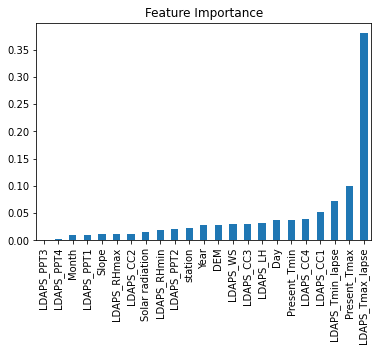

In [213]:
coef = pd.Series(final_model.feature_importances_, x.columns).sort_values()
coef.plot(kind = 'bar', title = 'Feature Importance')

## Graph

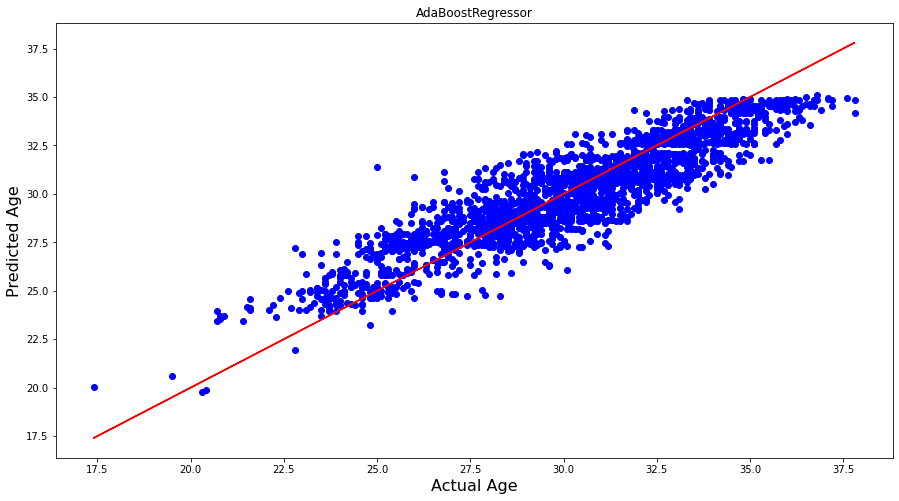

In [215]:
plt.figure(figsize = (15, 8))
plt.scatter(x = y_test, y  = final_pred, color = 'b')
plt.plot(y_test, y_test, color = 'r')
plt.xlabel('Actual Age', fontsize = 16)
plt.ylabel('Predicted Age', fontsize = 16)
plt.title('AdaBoostRegressor')
plt.show()

In [217]:
# As we are getting accuracy 80 % , accordingly we are getting points scattered point from the line.

## Deploy Model 

In [218]:
import pickle
filename = 'max_temperature.pkl'
pickle.dump(final_model, open(filename, 'wb'))

## Loading model

In [219]:
load_model =  pickle.load(open('max_temperature.pkl', 'rb'))
result = load_model.score(x_test, y_test)
print(result)

# 0.8054639833648554

0.8054639833648554


## Conclusion

In [220]:
predicted = np.array(load_model.predict(x_test))
original = np.array(y_test)
# convert columns in to np.array 

In [222]:
print(predicted.shape)
print(original.shape)
print(x_test.shape)
print(y_test.shape)
# (2277,)
# (2277,)
# (2277, 23)
# (2277,)

(2277,)
(2277,)
(2277, 23)
(2277,)


In [223]:
conclusion = pd.DataFrame({'Actual MaxTemperature': original, 'predicted MaxTemperature': predicted}, index = range(len(original)))

## Conclusion DataFrame

In [224]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
conclusion.sample(10)

,Actual MaxTemperature,predicted MaxTemperature
510,33.5,31.712782
1811,26.7,27.541193
154,26.8,30.666093
170,33.7,31.711615
206,30.1,30.758770
925,30.5,31.017346
344,26.2,27.360663
1628,32.4,31.871622
387,33.7,31.673748
575,29.9,29.949655


## Machine learning for ymin

### Model 1: LinearRegression

In [225]:
best_1 = best_randomstate(LinearRegression, x, ymin)
print(best_1)

[0, 1, 2, 3, 5, 9, 10, 12, 13, 14, 16, 17, 18, 21, 22, 23, 25, 27, 28, 33, 34, 35, 36, 38, 39, 40, 42, 49, 50, 53, 56, 61, 64, 65, 72, 75, 76, 83, 84, 85, 86, 88, 92, 94, 96, 98, 102, 106, 110, 111, 112, 113, 115, 117, 120, 125, 127, 130, 131, 135, 136, 140, 144, 145, 146, 147, 148, 149, 150, 152, 154, 155, 157, 158, 161, 162, 164, 165, 166, 167, 171, 176, 178, 179, 182, 184, 185, 187, 188, 189, 190, 197, 199]


In [232]:
check_model (LinearRegression, x, ymin, best_1)

At random state 0 the training r2_score is : 0.8034580949838772
At random state 0 the testing r2_score is : 0.8006610960458393
_________________________________________________________________
At random state 1 the training r2_score is : 0.8043942521838642
At random state 1 the testing r2_score is : 0.7966458589495496
_________________________________________________________________
At random state 2 the training r2_score is : 0.796903823204657
At random state 2 the testing r2_score is : 0.7950374884057747
_________________________________________________________________
At random state 3 the training r2_score is : 0.801753994366976
At random state 3 the testing r2_score is : 0.8004997768649718
_________________________________________________________________
At random state 5 the training r2_score is : 0.799399296372991
At random state 5 the testing r2_score is : 0.8013309986838647
_________________________________________________________________
At random state 9 the training r2_scor

At random state 125 the training r2_score is : 0.7996503551602697
At random state 125 the testing r2_score is : 0.801959845051142
_________________________________________________________________
At random state 127 the training r2_score is : 0.799083324381936
At random state 127 the testing r2_score is : 0.8027773637286086
_________________________________________________________________
At random state 130 the training r2_score is : 0.8001668156227997
At random state 130 the testing r2_score is : 0.8009591173934233
_________________________________________________________________
At random state 131 the training r2_score is : 0.8035031719038108
At random state 131 the testing r2_score is : 0.800477542691842
_________________________________________________________________
At random state 135 the training r2_score is : 0.8005170853762711
At random state 135 the testing r2_score is : 0.8006140988998236
_________________________________________________________________
At random state 13

Training r2_score is : 0.8024732207005599
Testing r2_score is : 0.8028152538959107
__________________________________________________________________
Mean Squared Error:  1.0368938147907119
Mean Absolute error:  0.7859688978658226
___________________________________________________________________


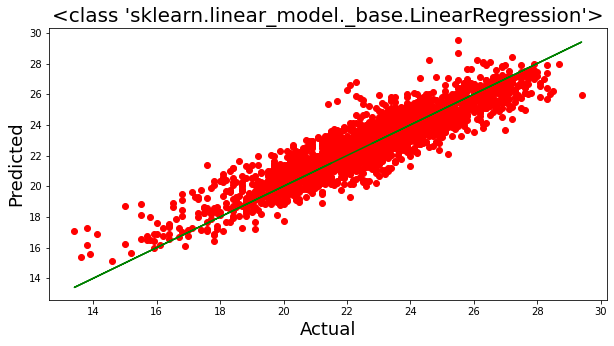

In [233]:
# By above observation, model is givig best performace at random state 149
train(LinearRegression, x, ymin, 149)

In [234]:
for val in range (2, 8):
    cv = cross_val_score(LinearRegression(), x, ymin, cv = val).mean()
    print('cv score is', cv, 'at cross fold value', val)

cv score is 0.7997052159972964 at cross fold value 2
cv score is 0.7708868123710936 at cross fold value 3
cv score is 0.7771171580035561 at cross fold value 4
cv score is 0.7714556658753662 at cross fold value 5
cv score is 0.7537279442653496 at cross fold value 6
cv score is 0.7632759566118165 at cross fold value 7


In [ ]:
# Training r2_score is : 0.8024732207005599
# Testing r2_score is : 0.8028152538959107
# __________________________________________________________________
# Mean Squared Error:  1.0368938147907119
# Mean Absolute error:  0.7859688978658226

# Highest Cv value 0.799705 at cross fold 2

### Model2 : AdaBoostRegressor

In [235]:
best_2 = best_randomstate(AdaBoostRegressor, x, ymin)
print(best_2)

[7, 24, 38, 40, 43, 52, 53, 62, 66, 67, 76, 90, 104, 106, 109, 111, 123, 131, 135, 149, 168, 171, 174, 175, 187, 194]


In [236]:
check_model (AdaBoostRegressor, x, ymin, best_2)

At random state 7 the training r2_score is : 0.7562432469605466
At random state 7 the testing r2_score is : 0.7617340898741671
_________________________________________________________________
At random state 24 the training r2_score is : 0.7551987111028406
At random state 24 the testing r2_score is : 0.7602762387884011
_________________________________________________________________
At random state 38 the training r2_score is : 0.7695867870163783
At random state 38 the testing r2_score is : 0.7616407692366559
_________________________________________________________________
At random state 40 the training r2_score is : 0.7621592224973643
At random state 40 the testing r2_score is : 0.756953166393422
_________________________________________________________________
At random state 43 the training r2_score is : 0.7726505836337574
At random state 43 the testing r2_score is : 0.7798890991127846
_________________________________________________________________
At random state 52 the train

Training r2_score is : 0.7684297223907104
Testing r2_score is : 0.7651501133230574
__________________________________________________________________
Mean Squared Error:  1.1238584489834929
Mean Absolute error:  0.8489502925893647
___________________________________________________________________


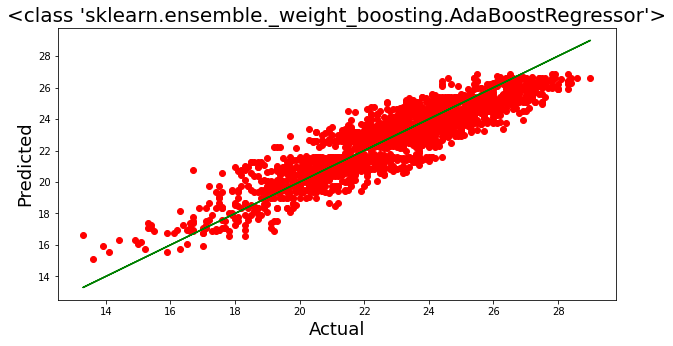

In [262]:
train(AdaBoostRegressor, x, ymin, 174)

In [241]:
for val in range (2, 8):
    cv = cross_val_score(AdaBoostRegressor(), x, ymin, cv = val).mean()
    print('cv score is', cv, 'at cross fold value', val)

cv score is 0.7559373982597897 at cross fold value 2
cv score is 0.717337615638317 at cross fold value 3
cv score is 0.7509904938592186 at cross fold value 4
cv score is 0.7447786087298506 at cross fold value 5
cv score is 0.7134790896017909 at cross fold value 6
cv score is 0.7222441831464536 at cross fold value 7


In [ ]:
# Training r2_score is : 0.7666588318896476
# Testing r2_score is : 0.7660422500504103
# __________________________________________________________________
# Mean Squared Error:  1.1078051984555697
# Mean Absolute error:  0.8407463073558294

# Highest cv score 0.755937 at cross fold 2

#### Model 3: DecisionTreeRegressor

In [243]:
from sklearn.tree import DecisionTreeRegressor

In [256]:
# Finding best accuracy random state
max_acc2 = 0
random_s2 = 0

for i in range(200):
    x_train, x_test, y_train, y_test = train_test_split(x, ymin, test_size = 0.30, random_state = i)
    model2 = DecisionTreeRegressor()
    model2.fit(x_train, y_train)
    model2_predict = model2.predict(x_test)
    acc = r2_score(y_test, model2_predict )
    
    if acc > max_acc2:
        max_acc2 = acc
        random_s2 = i
print('Model is giving best accurancy', max_acc2, 'on random state of', random_s2 )

# Model is giving best accurancy 0.8107756575733165 on random state of 17

Model is giving best accurancy 0.8107756575733165 on random state of 17


Training r2_score is : 1.0
Testing r2_score is : 0.8055410034072407
__________________________________________________________________
Mean Squared Error:  1.2370663153271853
Mean Absolute error:  0.8096618357487924
___________________________________________________________________


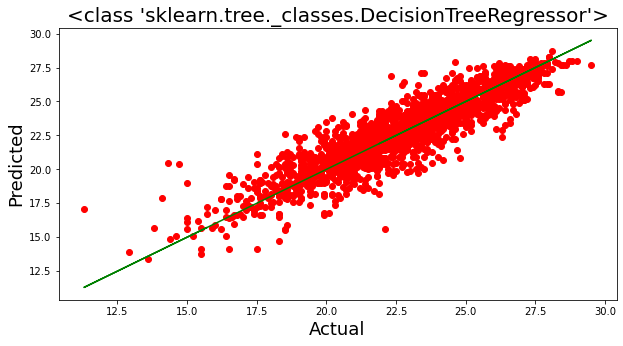

In [257]:
train(DecisionTreeRegressor, x, ymin, 17)

In [253]:
for val in range (2, 8):
    cv = cross_val_score(DecisionTreeRegressor(), x, ymin, cv = val).mean()
    print('cv score is', cv, 'at cross fold value', val)

cv score is 0.6288235444317578 at cross fold value 2
cv score is 0.5263128617345998 at cross fold value 3
cv score is 0.5468322340844411 at cross fold value 4
cv score is 0.5456145933823273 at cross fold value 5
cv score is 0.5227148728732898 at cross fold value 6
cv score is 0.5494869523309848 at cross fold value 7


In [254]:
# Training r2_score is : 1.0
# Testing r2_score is : 0.8055410034072407
# __________________________________________________________________
# Mean Squared Error:  1.2370663153271853
# Mean Absolute error:  0.8096618357487924

# Highest cv score 0.628823 at cross fold 2

#### Model 4: SVR (Support Vector Regressor)

In [255]:
from sklearn.svm import SVR

In [258]:
# Finding best accuracy random state
max_acc2 = 0
random_s2 = 0

for i in range(200):
    x_train, x_test, y_train, y_test = train_test_split(x, ymin, test_size = 0.30, random_state = i)
    model2 = SVR()
    model2.fit(x_train, y_train)
    model2_predict = model2.predict(x_test)
    acc = r2_score(y_test, model2_predict )
    
    if acc > max_acc2:
        max_acc2 = acc
        random_s2 = i
print('Model is giving best accurancy', max_acc2, 'on random state of', random_s2 )

# Model is giving best accurancy 0.9172659051453086 on random state of 24

Model is giving best accurancy 0.9172659051453086 on random state of 24


Training r2_score is : 0.9162635818542603
Testing r2_score is : 0.9006488031221415
__________________________________________________________________
Mean Squared Error:  0.540808330689329
Mean Absolute error:  0.5577910154951871
___________________________________________________________________


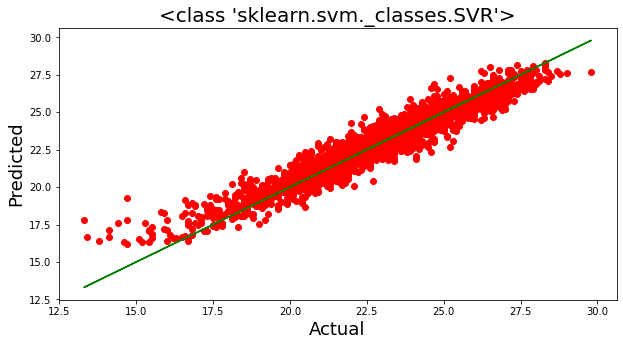

In [259]:
train(SVR, x, ymin, 24)

In [260]:
for val in range (2, 8):
    cv = cross_val_score(SVR(), x, ymin, cv = val).mean()
    print('cv score is', cv, 'at cross fold value', val)

cv score is 0.6943060338121992 at cross fold value 2
cv score is 0.6786600365348266 at cross fold value 3
cv score is 0.6797946304979208 at cross fold value 4
cv score is 0.7020926196424628 at cross fold value 5
cv score is 0.6683188550295062 at cross fold value 6
cv score is 0.6781173350645243 at cross fold value 7


In [261]:
# Training r2_score is : 0.9162635818542603
# Testing r2_score is : 0.9006488031221415
# __________________________________________________________________
# Mean Squared Error:  0.540808330689329
# Mean Absolute error:  0.5577910154951871

# highest cv score 0.702092 at cross fold 5

In [265]:
# Model	                Accuracy of Train	    Accuracy of Test	      CV	          Difference
# LinearRegression	     0.802473	            0.802815	             0.799705	      0.00311
# AdaBoostRegressor	     0.766658	            0.766042	             0.755937	      0.010105
# DecisionTreeRegressor	 1	                    0.805541	             0.628823	      0.176718
# SVR	                 0.916263	            0.900648	             0.702092	      0.198556

# Linear model is giving best model as it is showing least differnce between cv and accuracy
# AdaBoost model is also giving good result but having more cv and accuracy difference as compare to Linear Model
# DecisionTreeRegressor is giving overfitted model
# Svr model is giving highest difference between cv and accuracy
# Therefore, as least cv score and accuracy difference model is Linear Regression, we consider this model as final model


### Final Model LinearRegression

#### Ensemble on LinearRegression

In [267]:
parameter = {'n_jobs' : [2,3,4,5],
             'fit_intercept' : [True, False],
             'positive' : [True, False], 
            'normalize' : [True, False]}

In [268]:
gcv = GridSearchCV(estimator = LinearRegression(), param_grid = parameter, cv = 5)
gcv.fit(x_train, y_train)


GridSearchCV(cv=5, estimator=LinearRegression(),
             param_grid={'fit_intercept': [True, False], 'n_jobs': [2, 3, 4, 5],
                         'normalize': [True, False],
                         'positive': [True, False]})

In [269]:
gcv.best_params_

# {'fit_intercept': True, 'n_jobs': 2, 'positive': True}

{'fit_intercept': True, 'n_jobs': 2, 'normalize': True, 'positive': False}

In [270]:
# Finding best accuracy random state
max_acc2 = 0
random_s2 = 0

for i in range(200):
    x_train, x_test, y_train, y_test = train_test_split(x, ymin, test_size = 0.30, random_state = i)
    model2 = LinearRegression(fit_intercept = True, n_jobs = 2, positive =False, normalize = True)
    model2.fit(x_train, y_train)
    model2_predict = model2.predict(x_test)
    acc = r2_score(y_test, model2_predict )
    
    if acc > max_acc2:
        max_acc2 = acc
        random_s2 = i
print('Model is giving best accurancy', max_acc2, 'on random state of', random_s2 )

# Model is giving best accurancy 0.8511367331786538 on random state of 103

Model is giving best accurancy 0.8511367331786538 on random state of 103


In [275]:
x_train, x_test, y_train, y_test = train_test_split(x, ymin, test_size = 0.30, random_state = 103)
final_model2 = LinearRegression(fit_intercept = True, n_jobs = 2, positive =False, normalize = True)
final_model2.fit(x_train, y_train)
final_pred2 = final_model2.predict(x_test)
final_pred_train2 = final_model2.predict(x_train)

final_Train_accuracy2 = r2_score(y_train, final_pred_train2 )
final_Test_accuracy2 = r2_score(y_test, final_pred2 )
print('Training accuracy: ', final_Train_accuracy2)
print('Testing accuracy: ', final_Test_accuracy2)
print('______________________________________________')
print('Mean squared error: ', mean_squared_error(final_pred2, y_test) )
print('Mean absolute error: ', mean_absolute_error(final_pred2, y_test) )

# Training accuracy:  0.8266031071364339
# Testing accuracy:  0.8511367331786538
# ______________________________________________
# Mean squared error:  0.9520776973085245
# Mean absolute error:  0.7612596686600908

Training accuracy:  0.8266031071364339
Testing accuracy:  0.8511367331786538
______________________________________________
Mean squared error:  0.9520776973085245
Mean absolute error:  0.7612596686600908


In [276]:
# Having not much difference in train and test dataset accuracy

### Feature importance Graph

<AxesSubplot:title={'center':'Model Coefficients'}>

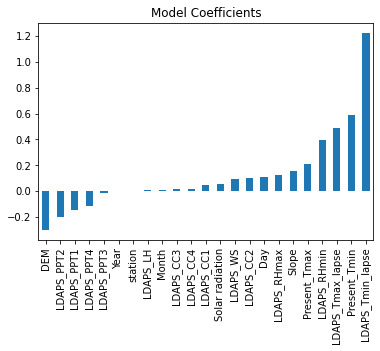

In [277]:
coef = pd.Series(final_model2.coef_, x.columns).sort_values()
coef.plot(kind = 'bar', title = 'Model Coefficients')

### Graph

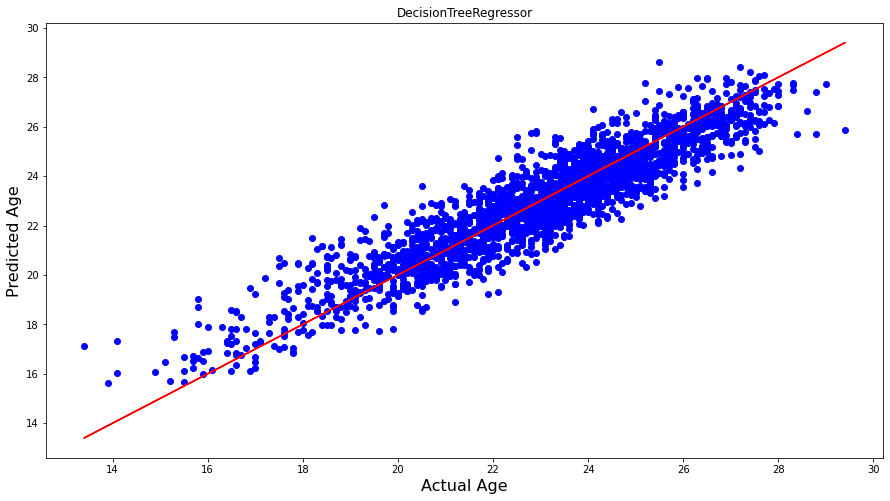

In [278]:
plt.figure(figsize = (15, 8))
plt.scatter(x = y_test, y  = final_pred2, color = 'b')
plt.plot(y_test, y_test, color = 'r')
plt.xlabel('Actual Age', fontsize = 16)
plt.ylabel('Predicted Age', fontsize = 16)
plt.title('DecisionTreeRegressor')
plt.show()

### Deploy Model of ymin

In [279]:
import pickle
filename = 'min_temperature.pkl'
pickle.dump(final_model2, open(filename, 'wb'))

### Load model

In [280]:
load_model2 =  pickle.load(open('min_temperature.pkl', 'rb'))
result2 = load_model2.score(x_test, y_test)
print(result2)

# 0.8511367331786538

0.8511367331786538


### Conclusion for ymin

In [286]:
predicted2 = np.array(load_model2.predict(x_test))
original2 = np.array(y_test)
# convert columns in to np.array 

In [287]:
print(predicted2.shape)
print(original2.shape)
print(x_test.shape)
print(y_test.shape)
# (2277,)
# (2277,)
# (2277, 23)
# (2277,)

(2277,)
(2277,)
(2277, 23)
(2277,)


In [288]:
conclusion2 = pd.DataFrame({'Actual MinTemperature': original2, 'predicted MinTemperature': predicted2}, index = range(len(original2)))

In [289]:
conclusion2.head()  # Result for Predicting min Temperature  (Next_Tmin)

,Actual MinTemperature,predicted MinTemperature
0,21.7,20.965906
1,25.0,25.292648
2,19.4,18.717912
3,26.0,25.488993
4,21.8,22.469965


In [290]:
conclusion.head()  # Result for Predicting max Temperature (Next_Tmax)

,Actual MaxTemperature,predicted MaxTemperature
0,34.1,34.252191
1,24.7,25.815842
2,31.0,30.061566
3,31.4,30.604471
4,29.3,28.784449
